# **Group 24**:


Lourenço Passeiro 20221838

Peter Lekszycki 20221840

Tomás Gonçalves 20221894

The notebook has some checkpoints in order to avoid the burden of waiting for running all!
Checkpoints on:
- Preprocessed dataset
- Reduced dataset
- Labeled dataset

## Imports

In [2]:
# Essentials
import pandas as pd
import numpy as np
from datetime import datetime
from math import pi
from tqdm import trange

# Big functions we used
from utils import plot_dendrogram, visualize_data_points_grid, visualize_dimensionality_reduction

# Visualizations
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib.colors import TABLEAU_COLORS
from scipy.stats import spearmanr

# SkLearn - Preprocessing & Clusterning
from sklearn.preprocessing import RobustScaler
from sklearn.neighbors import NearestNeighbors, KNeighborsClassifier, KNeighborsRegressor
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import DBSCAN, MeanShift, KMeans, AgglomerativeClustering, estimate_bandwidth

# Clustering visualization
import umap
#!pip install minisom
from minisom import MiniSom
from matplotlib.patches import Patch

# Tensorflow, Keras - Autoencoders
import tensorflow as tf
from keras.datasets import mnist
from keras.models import Model, Sequential
from keras.layers import Dense, Input

# Folium - Geo Visualizations
#!pip install folium
import folium
from folium.plugins import HeatMap, MarkerCluster

# Association Rules
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
from mlxtend.preprocessing import TransactionEncoder
from pyECLAT import ECLAT
import ast

# Turning off warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning, message=".*ndim > 0.*")
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [20]:
# Importing our data
customer_basket = pd.read_csv('data/customer_basket.csv', index_col = 0)
customer_info = pd.read_csv('data/customer_info.csv', index_col = 1)
customer_info.drop('Unnamed: 0', axis=1, inplace=True)
product_mapping = pd.read_excel('data/product_mapping.xlsx', index_col = 0)

## Initial exploratory analysis and visualizations:

We started by taking a look at our data, to better understand it.

In [84]:
customer_basket.head()

,list_of_goods,customer_id
invoice_id,,
7448187,"['olive oil', 'yogurt cake', 'grated cheese', ...",43134
3167314,"['babies food', 'shower gel', 'rice', 'black b...",43134
10199712,"['babies food', 'barbecue sauce', 'olive oil',...",43134
12179179,"['babies food', 'milk', 'rice', 'yogurt cake',...",43134
8292388,"['napkins', 'cookies', 'razor', 'cooking oil',...",43134


In [85]:
customer_info.tail()

,customer_name,customer_gender,customer_birthdate,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,...,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,loyalty_card_number,latitude,longitude
customer_id,,,,,,,,,,,,,,,,,,,,,
48487,Amelia Crawford,female,08/28/1983 11:43 AM,1.0,1.0,0.0,1.0,7189.0,6293.0,17.0,...,3779.0,1748.0,4387.0,2812.0,14.0,0.233259,2016.0,NaN,38.760694,-9.166146
24856,Silvia Ramos,female,09/21/1992 07:16 PM,1.0,1.0,1.0,1.0,11238.0,11490.0,12.0,...,3893.0,1621.0,3831.0,2726.0,25.0,0.060977,2014.0,909859.0,38.760280,-9.166643
21373,Addie Coronel,female,02/20/1994 05:58 AM,0.0,0.0,0.0,1.0,6059.0,241.0,12.0,...,142.0,179.0,0.0,11242.0,44.0,0.097672,2017.0,NaN,38.769923,-9.181550
19527,Msc. Mary Ross,female,08/06/1989 04:39 PM,1.0,0.0,1.0,1.0,3098.0,425.0,6.0,...,0.0,393.0,210.0,422.0,178.0,0.182188,2007.0,933102.0,38.760889,-9.174663
5120,Bsc. Milton Friend,male,06/19/1957 10:53 AM,2.0,0.0,2.0,1.0,6869.0,1554.0,10.0,...,1221.0,1871.0,1427.0,1789.0,1000.0,0.132793,2002.0,916045.0,38.734653,-9.178260


In [86]:
customer_info.describe(include='all')

,customer_name,customer_gender,customer_birthdate,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,...,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,loyalty_card_number,latitude,longitude
count,43631,43631,43631,43107.000000,42610.000000,42977.000000,42322.000000,43631.000000,43631.000000,41886.000000,...,42322.000000,43631.000000,43631.000000,43631.000000,43631.000000,43631.000000,43631.000000,24654.000000,43631.000000,43631.000000
unique,42351,2,43594,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,James Brown,female,08/13/1962 08:48 PM,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,10,21910,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,1.081263,0.847829,0.705726,1.669959,5600.030047,2000.058468,13.520580,...,1471.423846,916.948408,990.334922,2023.225619,387.260182,0.229431,2011.342257,949808.661069,38.752266,-9.158591
std,NaN,NaN,NaN,1.239257,0.840397,0.624624,1.034825,4602.647746,3004.924537,4.558057,...,3910.163766,729.744050,1241.658577,2926.355387,411.436756,0.189242,4.656129,28894.251301,0.048629,0.036606
min,NaN,NaN,NaN,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,6.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,-0.477986,1996.000000,900008.000000,38.690636,-9.418076
25%,NaN,NaN,NaN,0.000000,0.000000,0.000000,1.000000,2184.500000,218.000000,10.000000,...,187.000000,372.000000,204.000000,517.000000,97.000000,0.111704,2008.000000,924774.000000,38.732481,-9.175824
50%,NaN,NaN,NaN,1.000000,1.000000,1.000000,1.000000,4071.000000,574.000000,13.000000,...,641.000000,668.000000,557.000000,874.000000,252.000000,0.205235,2011.000000,949681.000000,38.748887,-9.160152
75%,NaN,NaN,NaN,1.000000,1.000000,1.000000,2.000000,6605.500000,2565.500000,17.000000,...,1570.000000,1437.000000,1111.000000,2217.000000,537.000000,0.310884,2014.000000,975117.250000,38.764504,-9.139240


Boxplot evaluation of each category lifetime spendings

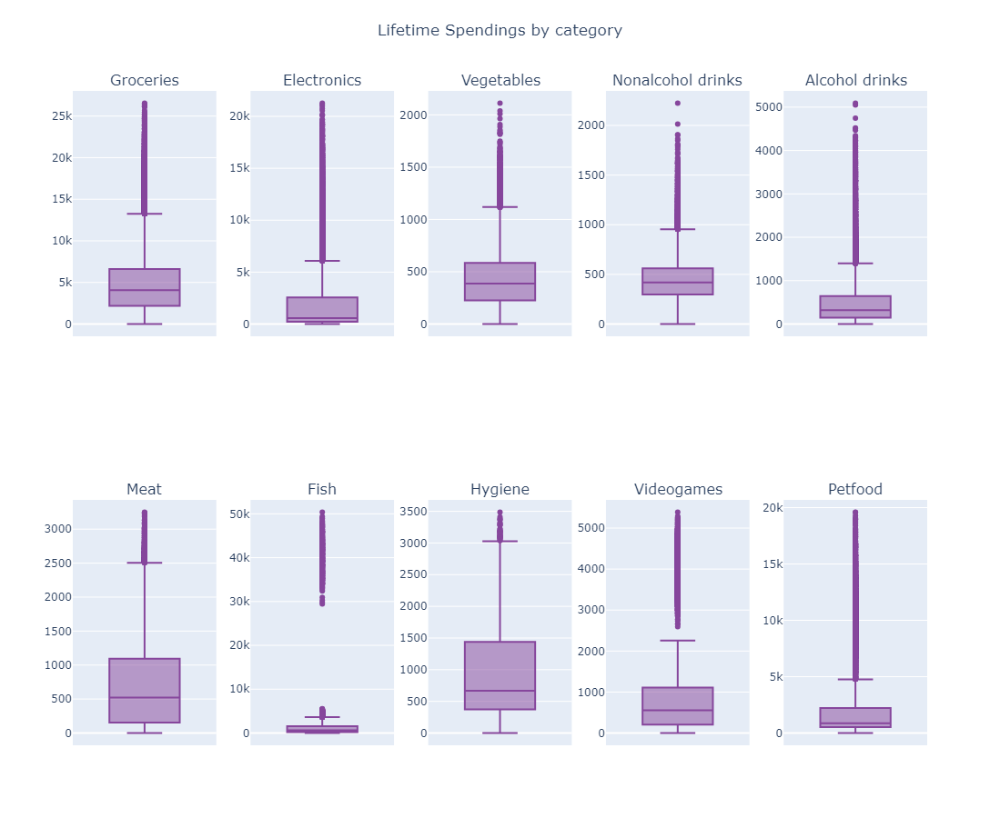

In [87]:
# Filtering only the variables we want
rel = customer_info[ [col for col in customer_info.columns if 'lifetime_spend' in str(col)] ]

labels = ['Groceries', 'Electronics', 'Vegetables', 'Nonalcohol drinks', 'Alcohol drinks', 'Meat', 'Fish',
          'Hygiene', 'Videogames', 'Petfood']

fig2 = make_subplots(rows=2, cols=5, subplot_titles=(labels))

for i, (col, label) in enumerate(zip(rel.columns, labels), start=1):
    fig2.append_trace(go.Box(y=rel[col], marker=dict(color='#86469C'), name=''), row=(i-1)//5 + 1, col=(i-1)%5 + 1)

fig2.update_layout(showlegend=False, title_text="Lifetime Spendings by category", title_x=0.5, title_y=0.97, height=900, width=1150)

fig2.show()

By looking to each one of the boxplots we can see that all of the categories have a high number of outliers.

Distribution of some demographic features:

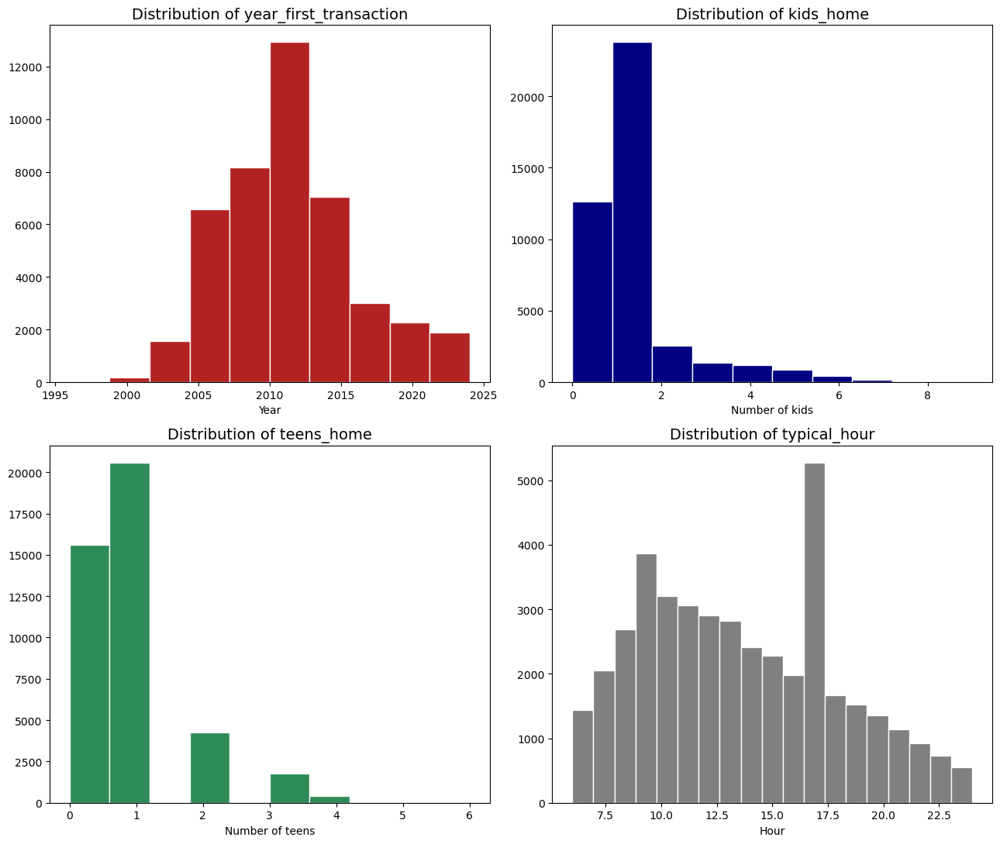

In [88]:
fig, axs = plt.subplots(2,2, figsize=(13,11))

axs[0, 0].hist(customer_info.year_first_transaction, color='firebrick', edgecolor='white')
axs[0, 0].set_title('Distribution of year_first_transaction', fontsize=14)
axs[0, 0].set_xlabel('Year')

axs[0, 1].hist(customer_info.kids_home, color='navy', edgecolor='white')
axs[0, 1].set_title('Distribution of kids_home', fontsize=14)
axs[0, 1].set_xlabel('Number of kids')

axs[1, 0].hist(customer_info.teens_home, color='seagreen', edgecolor='white')
axs[1, 0].set_title('Distribution of teens_home', fontsize=14)
axs[1, 0].set_xlabel('Number of teens')


axs[1, 1].hist(customer_info.typical_hour, color='grey', bins=24-5, edgecolor='white')
axs[1, 1].set_title('Distribution of typical_hour', fontsize=14)
axs[1, 1].set_xlabel('Hour')

plt.tight_layout()
plt.show()

Let's check where are our clients located:

In [89]:
latitudes = customer_info.latitude.values
longitudes = customer_info.longitude.values

In [90]:
mymap = folium.Map(location=[latitudes[0], longitudes[0]], zoom_start=10)

heatmap_data = list(zip(latitudes, longitudes))
HeatMap(heatmap_data).add_to(mymap)

mymap

As we can see, most of our clients are located on the metropolitan area of Lisbon.

## Data Preprocessing

### - Data Cleaning

Here we went over some procedures in order to clean our datasets - handled missing data, removed duplicates, and corrected inconsistencies in the data.

product_mapping:

In [91]:
product_mapping.info() # no missing values

<class 'pandas.core.frame.DataFrame'>
Index: 165 entries, champagne to cat food
Data columns (total 1 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   category  165 non-null    object
dtypes: object(1)
memory usage: 2.6+ KB


In [92]:
product_mapping.head()

,category
product_name,
champagne,alcohol_drinks
bramble,alcohol_drinks
white wine,alcohol_drinks
dessert wine,alcohol_drinks
french wine,alcohol_drinks


In [93]:
product_mapping.index.duplicated().sum() # there is two product with duplicates

2

In [94]:
product_mapping.index.value_counts() # the product are 'asparagus' and 'airpods'

product_name
asparagus          2
airpods            2
champagne          1
mineral water      1
ground beef        1
                  ..
gluten free bar    1
protein bar        1
almonds            1
low fat yogurt     1
cat food           1
Name: count, Length: 163, dtype: int64

In [95]:
product_mapping.reset_index(inplace=True) # resetting the index in order to easily drop the intended duplicates

In [96]:
product_mapping.loc[product_mapping.product_name.isin(['asparagus', 'airpods'])] # filtering only the duplicate products, to get their indexes

,product_name,category
14,airpods,electronics
127,asparagus,vegetables
134,asparagus,vegetables
152,airpods,videogames


In [97]:
product_mapping.drop([127, 152], inplace=True) # dropping them

In [98]:
product_mapping.set_index('product_name', inplace=True) # setting the index again on the product_name
product_mapping

,category
product_name,
champagne,alcohol_drinks
bramble,alcohol_drinks
white wine,alcohol_drinks
dessert wine,alcohol_drinks
french wine,alcohol_drinks
...,...
final fantasy XX,videogames
final fantasy XIX,videogames
final fantasy XXII,videogames


customer_basket:

In [99]:
customer_basket.head()

,list_of_goods,customer_id
invoice_id,,
7448187,"['olive oil', 'yogurt cake', 'grated cheese', ...",43134
3167314,"['babies food', 'shower gel', 'rice', 'black b...",43134
10199712,"['babies food', 'barbecue sauce', 'olive oil',...",43134
12179179,"['babies food', 'milk', 'rice', 'yogurt cake',...",43134
8292388,"['napkins', 'cookies', 'razor', 'cooking oil',...",43134


As we can see, the dataset has no missing values.

In [100]:
customer_basket.info()

<class 'pandas.core.frame.DataFrame'>
Index: 89952 entries, 7448187 to 8150061
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   list_of_goods  89952 non-null  object
 1   customer_id    89952 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 2.1+ MB


However, it has 301 duplicates of invoices.

In [101]:
customer_basket.index.duplicated().sum()

301

In [102]:
customer_basket.index.value_counts()

invoice_id
10907271    2
5002654     2
9701488     2
1887198     2
2674958     2
           ..
7097977     1
6723199     1
4462958     1
4895679     1
8150061     1
Name: count, Length: 89651, dtype: int64

In [103]:
customer_basket[customer_basket.index.duplicated() == True]

,list_of_goods,customer_id
invoice_id,,
2674958,"['green beans', 'tomatoes', 'burgers', 'carrot...",26604
2877777,"['salmon', 'shallot', 'airpods', 'escalope', '...",6081
78942,"['cologne', 'napkins', 'cereals', 'cake', 'coo...",25317
3688852,"['babies food', 'shrimp', 'cologne', 'ground b...",27034
2027997,"['melons', 'tomatoes', 'toilet paper', 'iPad',...",40483
...,...,...
4488958,"['shower gel', 'napkins', 'chocolate bread', '...",25630
9079941,"['green beans', 'shower gel', 'melons', 'aspar...",21116
7614681,"['turkey', 'ground beef', 'cooking oil', 'cake...",43362


As we can see by the examples below, the duplicates appeared when the 'list_of_goods' is the same between purchases, probably from an error on the companies system.

In [104]:
customer_basket.loc[2674958]

,list_of_goods,customer_id
invoice_id,,
2674958,"['green beans', 'tomatoes', 'burgers', 'carrot...",9665
2674958,"['green beans', 'tomatoes', 'burgers', 'carrot...",26604


In [105]:
customer_basket.loc[2877777]

,list_of_goods,customer_id
invoice_id,,
2877777,"['salmon', 'shallot', 'airpods', 'escalope', '...",31964
2877777,"['salmon', 'shallot', 'airpods', 'escalope', '...",6081


In [106]:
customer_basket.loc[9664244]

,list_of_goods,customer_id
invoice_id,,
9664244,"['babies food', 'rice', 'pickles', 'whole weat...",24395
9664244,"['babies food', 'rice', 'pickles', 'whole weat...",27337


Given this, we removed every duplicate, keeping only one of each group.

In [107]:
customer_basket = customer_basket.loc[~customer_basket.index.duplicated(keep='first')]
print(customer_basket.index.duplicated().sum())

0


customer_info:

Here, we don't have duplicated customers.

In [108]:
customer_info.index.duplicated().sum()

0

As we saw on the beggining, we have a very high number of outliers on most of the lifetime spending categories. We will not deal with it now, in order to don't risk losing valuable information.

We also got some missing values:

In [109]:
customer_info.info()

<class 'pandas.core.frame.DataFrame'>
Index: 43631 entries, 39634 to 5120
Data columns (total 24 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   customer_name                            43631 non-null  object 
 1   customer_gender                          43631 non-null  object 
 2   customer_birthdate                       43631 non-null  object 
 3   kids_home                                43107 non-null  float64
 4   teens_home                               42610 non-null  float64
 5   number_complaints                        42977 non-null  float64
 6   distinct_stores_visited                  42322 non-null  float64
 7   lifetime_spend_groceries                 43631 non-null  float64
 8   lifetime_spend_electronics               43631 non-null  float64
 9   typical_hour                             41886 non-null  float64
 10  lifetime_spend_vegetables                42758 n

% of Missing Values per column:

In [110]:
mv_ci = customer_info.isnull().sum()    # getting a series with the total number of missing values per feature
mv_ci = mv_ci.loc[mv_ci != 0]    # removing the features with 0 missing values
mv_ci = ( mv_ci / len(customer_info) )*100    # printing the % of missing values per feature
mv_ci

kids_home                     1.200981
teens_home                    2.340079
number_complaints             1.498934
distinct_stores_visited       3.000160
typical_hour                  3.999450
lifetime_spend_vegetables     2.000871
lifetime_spend_fish           3.000160
loyalty_card_number          43.494305
dtype: float64

In the remaining variables with missing values, we can see that they only have 1-4% of missing values. Since the missing data is such a small proportion, we have conditions to try to impute it.

Before doing the imputations, there are some variables that need to be transformed to be better processed:

### Data Transformations:

#### Feature transformations:

Firstly, we can assume that the missing values on loyalty_card_number are not a problem and due to some clients not having a 'loyalty card'. Giving this, the ownership of a 'loyalty card' can better be represented in a binary variable, that indicates whether a client has one (and the number of each loyalty card is not relevant at all).

In [111]:
# We created a copy (Customer Info PreProcessed) of the our customer_info dataset in order to do all transformations there, and preserve all the information
# in the original dataset, that could be necessary later on
customer_info_pp = customer_info.copy()

In [112]:
# creating the new binary loyalty card variable
customer_info_pp['loyalty_card_binary'] = (customer_info_pp['loyalty_card_number'].notnull()).astype(int)
# dropping the old loyalty card variable
customer_info_pp.drop('loyalty_card_number', axis=1, inplace=True) # only run once

In [113]:
customer_info_pp.head(3)

,customer_name,customer_gender,customer_birthdate,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,...,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,latitude,longitude,loyalty_card_binary
customer_id,,,,,,,,,,,,,,,,,,,,,
39634,David Frink,male,05/15/1964 10:34 PM,1.0,1.0,1.0,2.0,18306.0,7106.0,17.0,...,4056.0,2174.0,3946.0,2514.0,32.0,0.072206,2010.0,38.735637,-9.149071,0
43460,Belinda Terry,female,03/26/1988 11:06 PM,1.0,0.0,1.0,2.0,5015.0,1334.0,8.0,...,1925.0,2115.0,1028.0,1987.0,2566.0,0.206227,2014.0,38.762702,-9.160802,0
23937,Evelyn Calico,female,04/13/1969 06:07 PM,0.0,1.0,1.0,3.0,3097.0,4073.0,10.0,...,2347.0,1306.0,1504.0,2018.0,1282.0,0.136168,2009.0,38.717431,-9.165105,1


customer_gender:

In [114]:
# trasnforming the gender variable into a binary one
customer_info_pp['female'] = customer_info_pp['customer_gender'].apply(lambda x: 1 if x == 'female' else 0)
customer_info_pp.drop('customer_gender', axis=1, inplace=True) # only run once

In [115]:
customer_info_pp.tail(3)

,customer_name,customer_birthdate,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,lifetime_spend_vegetables,...,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,latitude,longitude,loyalty_card_binary,female
customer_id,,,,,,,,,,,,,,,,,,,,,
21373,Addie Coronel,02/20/1994 05:58 AM,0.0,0.0,0.0,1.0,6059.0,241.0,12.0,289.0,...,179.0,0.0,11242.0,44.0,0.097672,2017.0,38.769923,-9.181550,0,1
19527,Msc. Mary Ross,08/06/1989 04:39 PM,1.0,0.0,1.0,1.0,3098.0,425.0,6.0,866.0,...,393.0,210.0,422.0,178.0,0.182188,2007.0,38.760889,-9.174663,1,1
5120,Bsc. Milton Friend,06/19/1957 10:53 AM,2.0,0.0,2.0,1.0,6869.0,1554.0,10.0,268.0,...,1871.0,1427.0,1789.0,1000.0,0.132793,2002.0,38.734653,-9.178260,1,0


customer_birthdate:

In [116]:
# removing the time part of each birth date ( we don't really believe in astrological signs :) )
customer_info_pp['customer_birthdate'] = customer_info_pp['customer_birthdate'].apply(lambda x: x[:10])

In [117]:
# created a function that receives a birthdate as input and computes the age of that person
def calculate_age(birth_date):
    """
    Calculate the age of a person as of a fixed current date.
    This function computes the age based on the birth date provided and a set current date. The current date is fixed to March 25, 2024,
    which is the release date of the project. This fixed date prevents changes in calculated age as days pass after the release.

    Parameters:
    - birth_date (str): The birth date of the individual in the format 'MM/DD/YYYY'.

    Returns:
    - int: The age of the individual rounded to the nearest integer. The computation accounts for whether the birthday has occurred
           by the fixed current date within the current year.
    """

    current_date = datetime(2024, 3, 25) # our current date should be fixed, in order to dont let the ages modify as the days pass
                                         # the chosen date is the date the project was released

    birth_date_object = datetime.strptime(birth_date, "%m/%d/%Y") # transforming the string version of the dates into datetime objects

    age = current_date.year - birth_date_object.year - ((current_date.month, current_date.day) < (birth_date_object.month, birth_date_object.day))

    return round(age,2)

In [118]:
# applying the age function we created
customer_info_pp['age'] = customer_info_pp['customer_birthdate'].apply(calculate_age)
customer_info_pp.drop('customer_birthdate', axis=1, inplace=True)

customer_name

In [119]:
# dropping the name variable since it is unnecessary to predict the missing value
customer_info_pp.drop('customer_name', axis=1, inplace=True)

In [123]:
customer_info_pp.tail(3)

,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,...,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,latitude,longitude,loyalty_card_binary,female,age
customer_id,,,,,,,,,,,,,,,,,,,,,
21373,0.0,0.0,0.0,1.0,6059.0,241.0,12.0,289.0,420.0,43.0,...,0.0,11242.0,44.0,0.097672,2017.0,38.769923,-9.181550,0,1,30
19527,1.0,0.0,1.0,1.0,3098.0,425.0,6.0,866.0,369.0,222.0,...,210.0,422.0,178.0,0.182188,2007.0,38.760889,-9.174663,1,1,34
5120,2.0,0.0,2.0,1.0,6869.0,1554.0,10.0,268.0,659.0,1097.0,...,1427.0,1789.0,1000.0,0.132793,2002.0,38.734653,-9.178260,1,0,66


#### Missing values imputation

Going back to the missing values:

In [124]:
mv_cipp = customer_info_pp.isnull().sum()
mv_cipp = mv_cipp.loc[mv_cipp != 0]
mv_cipp = ( mv_cipp / len(customer_info_pp) )*100
mv_cipp

kids_home                    1.200981
teens_home                   2.340079
number_complaints            1.498934
distinct_stores_visited      3.000160
typical_hour                 3.999450
lifetime_spend_vegetables    2.000871
lifetime_spend_fish          3.000160
dtype: float64

Before addressing them, we should consider our outliers, who were seen on the boxplots.

We tried to remove the extreme outliers, however, after doing so, we had a much worse imputation accuracy. Given this, we decided to not do anything about them before imputation. Nevertheless, we decided to use the Robust Scaler, that is more robust to outliers than other scaling methods. It removes the median and scales the data according to the quantile range.

In [125]:
# splitting the numerical from the categorical variables, to apply the scaling on the numerical ones
cinfo_n = customer_info_pp.loc[:, ['lifetime_spend_groceries', 'lifetime_spend_electronics', 'lifetime_spend_vegetables',
                                  'lifetime_spend_nonalcohol_drinks', 'lifetime_spend_alcohol_drinks', 'lifetime_spend_meat',
                                  'lifetime_spend_fish', 'lifetime_spend_hygiene', 'lifetime_spend_videogames',
                                  'lifetime_spend_petfood', 'lifetime_total_distinct_products', 'percentage_of_products_bought_promotion',
                                  'year_first_transaction', 'latitude', 'longitude', 'age', 'typical_hour']]

cinfo_c = customer_info_pp.loc[:, ~customer_info_pp.columns.isin(cinfo_n.columns)]

In [126]:
scaler = RobustScaler().fit(cinfo_n)

scl_cinfo_n = pd.DataFrame(scaler.transform(cinfo_n), columns = cinfo_n.columns).set_index(cinfo_n.index)
customer_info_pp = scl_cinfo_n.join(cinfo_c)
customer_info_pp

,lifetime_spend_groceries,lifetime_spend_electronics,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,...,latitude,longitude,age,typical_hour,kids_home,teens_home,number_complaints,distinct_stores_visited,loyalty_card_binary,female
customer_id,,,,,,,,,,,,,,,,,,,,,
39634,3.219860,2.782535,0.271709,0.703422,1.243513,1.810840,2.469270,1.414085,3.736494,0.964706,...,-0.413753,0.302882,0.21875,0.571429,1.0,1.0,1.0,2.0,0,0
43460,0.213526,0.323749,-0.120448,-0.171103,1.790419,0.580234,0.928416,1.358685,0.519294,0.654706,...,0.431429,-0.017786,-0.53125,-0.714286,1.0,0.0,1.0,2.0,0,1
23937,-0.220312,1.490522,-0.240896,1.646388,2.816367,-0.080765,1.233550,0.599061,1.044101,0.672941,...,-0.982291,-0.135390,0.06250,-0.428571,0.0,1.0,1.0,3.0,1,1
2431,1.527709,-0.156337,-0.655462,-0.634981,-0.518962,-0.251860,-0.354302,-0.577465,-0.614112,1.918235,...,1.039332,0.268783,0.93750,0.571429,0.0,0.0,0.0,1.0,1,1
10090,-0.763176,-0.001704,-1.061625,-1.467681,5.015968,-0.497343,-0.339118,-0.076056,-0.368247,-0.476471,...,0.671703,-0.461193,-0.93750,NaN,0.0,0.0,0.0,1.0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48487,0.705270,2.436209,0.815126,1.224335,0.636727,1.112646,2.268980,1.014085,4.222712,1.140000,...,0.368723,-0.163844,-0.37500,0.571429,1.0,1.0,0.0,1.0,0,1
24856,1.621126,4.650053,0.602241,0.524715,2.361277,2.218916,2.351410,0.894836,3.609702,1.089412,...,0.355790,-0.177448,-0.65625,-0.142857,1.0,1.0,1.0,1.0,1,1
21373,0.449672,-0.141853,-0.274510,0.003802,-0.552894,-0.202976,-0.360810,-0.459155,-0.614112,6.098824,...,0.656926,-0.584899,-0.68750,-0.142857,0.0,0.0,0.0,1.0,0,1


In [127]:
pred = customer_info_pp.dropna()
pred.info()

<class 'pandas.core.frame.DataFrame'>
Index: 36673 entries, 39634 to 5120
Data columns (total 23 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   lifetime_spend_groceries                 36673 non-null  float64
 1   lifetime_spend_electronics               36673 non-null  float64
 2   lifetime_spend_vegetables                36673 non-null  float64
 3   lifetime_spend_nonalcohol_drinks         36673 non-null  float64
 4   lifetime_spend_alcohol_drinks            36673 non-null  float64
 5   lifetime_spend_meat                      36673 non-null  float64
 6   lifetime_spend_fish                      36673 non-null  float64
 7   lifetime_spend_hygiene                   36673 non-null  float64
 8   lifetime_spend_videogames                36673 non-null  float64
 9   lifetime_spend_petfood                   36673 non-null  float64
 10  lifetime_total_distinct_products         36673 n

For every imputation, we tried a range of 100 different Ks for each feature. The plots have only few Ks around the optimal one, to avoid the wait to run it all.

Imputation on kids_home:

After 5/6 kids, the frequencies start to become very small. Given this, and to facilitate predictions, we will consider every customer with more than 5 kids, to have 5. The value 5 on kids_home can now me interpreted as '5+ kids'.

In [128]:
pred.kids_home.value_counts()

kids_home
1.0    20256
0.0    10751
2.0     2172
3.0     1162
4.0      997
5.0      744
6.0      376
7.0      161
8.0       42
9.0       12
Name: count, dtype: int64

In [129]:
kids_map = {6:5, 7: 5, 8: 5, 9: 5}

customer_info_pp.loc[:,'kids_home'] = customer_info_pp['kids_home'].map(kids_map).fillna(customer_info_pp['kids_home'])
pred.loc[:,'kids_home'] = pred['kids_home'].map(kids_map).fillna(pred['kids_home'])

pred.kids_home.value_counts()

kids_home
1.0    20256
0.0    10751
2.0     2172
5.0     1335
3.0     1162
4.0      997
Name: count, dtype: int64

Best number of neighbors: 85
Mean accuracy in train with 85 neighbors: 0.722259
Mean accuracy in validation with 85 neighbors: 0.712510


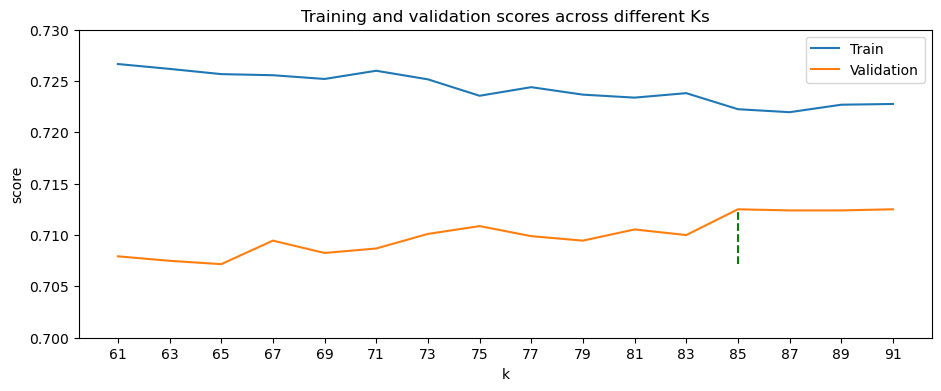

In [49]:
X = pred.drop(['kids_home'], axis = 1)
y = pred.kids_home

X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                 train_size = 0.75,
                                                 shuffle = True,
                                                 random_state = 15,
                                                 stratify = y)

numberK_list=np.arange(61,92,2)
high_score=0
nof=0
score_list_train =[]
score_list_val =[]
for n in numberK_list:
    model = KNeighborsClassifier(n_neighbors = n).fit(X_train, y_train)
    score_train = model.score(X_train, y_train)
    score_val = model.score(X_val, y_val)
    score_list_train.append(score_train)
    score_list_val.append(score_val)

    if(score_val>high_score):
            high_score = score_val
            nof = n
print("Best number of neighbors: %d" %nof)
print("Mean accuracy in train with %d neighbors: %f" % (nof, score_list_train[numberK_list.tolist().index(nof)]))
print("Mean accuracy in validation with %d neighbors: %f" % (nof, high_score))

fig, ax = plt.subplots(figsize=(11,4))
plt.plot(numberK_list, score_list_train, label='Train')
plt.plot(numberK_list, score_list_val, label = 'Validation')
plt.vlines(x=nof,ymax=high_score,ymin=min(score_list_val),ls='--',colors='g')
plt.xticks(numberK_list)
plt.xlabel('k')
plt.ylabel('score')
plt.ylim(0.7, 0.73)
plt.legend()
plt.title('Training and validation scores across different Ks')

plt.show()

Imputation on teens_home:

In [63]:
pred.teens_home.value_counts()

teens_home
1.0    17798
0.0    13367
2.0     3636
3.0     1503
4.0      330
5.0       38
6.0        1
Name: count, dtype: int64

After 4 teens, the frequencies start to become very small. Given this, and to facilitate predictions, we will consider every customer with more than 3 teens, to have 3. The value 3 on teens_home can now me interpreted as '3+ teens'.

In [130]:
teens_map = {4: 3, 5: 3, 6: 3, 7: 3, 8: 3, 9: 3}

# Apply the mapping to the DataFrame column
pred.loc[:,'teens_home'] = pred['teens_home'].map(teens_map).fillna(pred['teens_home'])
customer_info_pp.loc[:,'teens_home'] = customer_info_pp['teens_home'].map(kids_map).fillna(customer_info_pp['teens_home'])
pred.teens_home.value_counts()

teens_home
1.0    17798
0.0    13367
2.0     3636
3.0     1872
Name: count, dtype: int64

Best number of neighbors: 61
Mean accuracy in train with 61 neighbors: 0.718368
Mean accuracy in validation with 61 neighbors: 0.696041


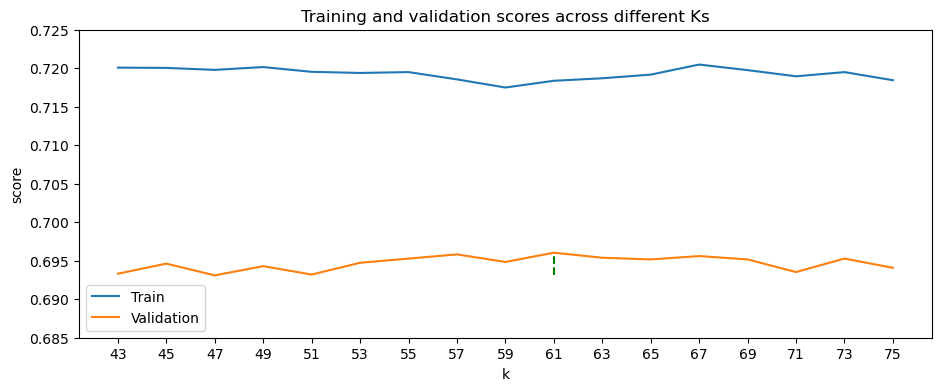

In [52]:
X = pred.drop(['teens_home'], axis = 1)
y = pred.teens_home

X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                 train_size = 0.75,
                                                 shuffle = True,
                                                 random_state = 15,
                                                 stratify = y)

numberK_list=np.arange(43,76,2)
high_score=0
nof=0
score_list_train =[]
score_list_val =[]
for n in numberK_list:
    model = KNeighborsClassifier(n_neighbors = n).fit(X_train, y_train)
    score_train = model.score(X_train, y_train)
    score_val = model.score(X_val, y_val)
    score_list_train.append(score_train)
    score_list_val.append(score_val)

    if(score_val>high_score):
            high_score = score_val
            nof = n
print("Best number of neighbors: %d" %nof)
print("Mean accuracy in train with %d neighbors: %f" % (nof, score_list_train[numberK_list.tolist().index(nof)]))
print("Mean accuracy in validation with %d neighbors: %f" % (nof, high_score))

fig, ax = plt.subplots(figsize=(11,4))
plt.plot(numberK_list, score_list_train, label='Train')
plt.plot(numberK_list, score_list_val, label = 'Validation')
plt.vlines(x=nof,ymax=high_score,ymin=min(score_list_val),ls='--',colors='g')
plt.xticks(numberK_list)
plt.xlabel('k')
plt.ylabel('score')
plt.legend()
plt.ylim(0.685, 0.725)
plt.title('Training and validation scores across different Ks')

plt.show()

Imputation on number_complaints:

In [53]:
pred.number_complaints.value_counts()

number_complaints
1.0    21233
0.0    13331
2.0     1931
3.0       68
4.0       45
5.0       37
6.0       14
7.0        6
8.0        6
9.0        2
Name: count, dtype: int64

After 3 complaints, the frequencies start to become very small. Given this, and to facilitate predictions, we will consider every customer with more than 3 complaints, to have 3. The value 3 on number_complaints can now me interpreted as '3+ complaints'.

In [131]:
complaints_map = {4: 3, 5: 3, 6: 3, 7: 3, 8: 3, 9: 3}

# Apply the mapping to the DataFrame column
pred.loc[:, 'number_complaints'] = pred['number_complaints'].map(complaints_map).fillna(pred['number_complaints'])
customer_info_pp.loc[:,'number_complaints'] = customer_info_pp['number_complaints'].map(complaints_map).fillna(customer_info_pp['number_complaints'])

pred.number_complaints.value_counts()

number_complaints
1.0    21233
0.0    13331
2.0     1931
3.0      178
Name: count, dtype: int64

Best number of neighbors: 65
Mean accuracy in train with 65 neighbors: 0.671939
Mean accuracy in validation with 65 neighbors: 0.657651


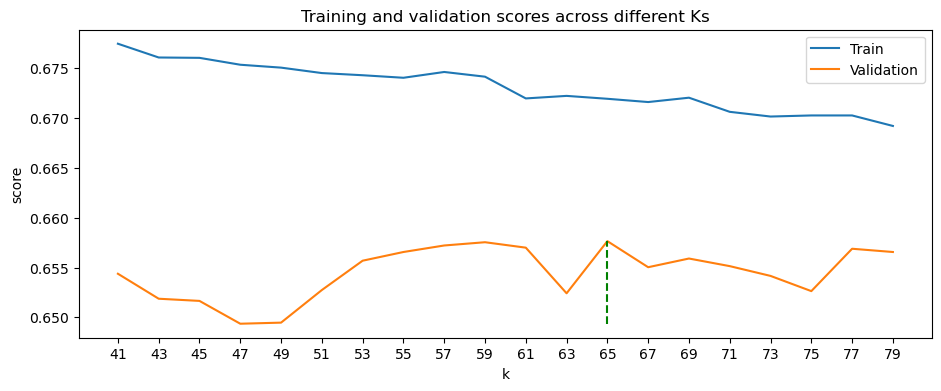

In [55]:
X = pred.drop(['number_complaints'], axis = 1)
y = pred.number_complaints

X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                 train_size = 0.75,
                                                 shuffle = True,
                                                 random_state = 15,
                                                 stratify = y)

numberK_list=np.arange(41,81,2)
high_score=0
nof=0
score_list_train =[]
score_list_val =[]
for n in numberK_list:
    model = KNeighborsClassifier(n_neighbors = n).fit(X_train, y_train)
    score_train = model.score(X_train, y_train)
    score_val = model.score(X_val, y_val)
    score_list_train.append(score_train)
    score_list_val.append(score_val)

    if(score_val>high_score):
            high_score = score_val
            nof = n
print("Best number of neighbors: %d" %nof)
print("Mean accuracy in train with %d neighbors: %f" % (nof, score_list_train[numberK_list.tolist().index(nof)]))
print("Mean accuracy in validation with %d neighbors: %f" % (nof, high_score))

fig, ax = plt.subplots(figsize=(11,4))
plt.plot(numberK_list, score_list_train, label='Train')
plt.plot(numberK_list, score_list_val, label = 'Validation')
plt.vlines(x=nof,ymax=high_score,ymin=min(score_list_val),ls='--',colors='g')
plt.xticks(numberK_list)
plt.xlabel('k')
plt.ylabel('score')
plt.legend()
plt.title('Training and validation scores across different Ks')

plt.show()

Imputation on typical_hour:

Best number of neighbors: 63
Mean accuracy in train with 63 neighbors: 0.291499
Mean accuracy in validation with 63 neighbors: 0.258162


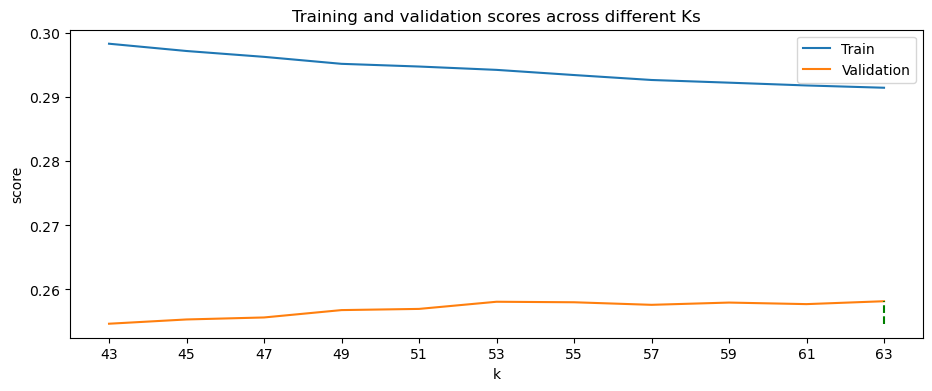

In [56]:
X = pred.drop(['typical_hour'], axis = 1)
y = pred.typical_hour

X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                 train_size = 0.75,
                                                 shuffle = True,
                                                 random_state = 15)

numberK_list=np.arange(43,64,2)
high_score=0
nof=0
score_list_train =[]
score_list_val =[]
for n in numberK_list:
    model = KNeighborsRegressor(n_neighbors = n).fit(X_train, y_train)
    score_train = model.score(X_train, y_train)
    score_val = model.score(X_val, y_val)
    score_list_train.append(score_train)
    score_list_val.append(score_val)

    if(score_val>high_score):
            high_score = score_val
            nof = n
print("Best number of neighbors: %d" %nof)
print("Mean accuracy in train with %d neighbors: %f" % (nof, score_list_train[numberK_list.tolist().index(nof)]))
print("Mean accuracy in validation with %d neighbors: %f" % (nof, high_score))

fig, ax = plt.subplots(figsize=(11,4))
plt.plot(numberK_list, score_list_train, label='Train')
plt.plot(numberK_list, score_list_val, label = 'Validation')
plt.vlines(x=nof,ymax=high_score,ymin=min(score_list_val),ls='--',colors='g')
plt.xticks(numberK_list)
plt.xlabel('k')
plt.ylabel('score')
plt.legend()
plt.title('Training and validation scores across different Ks')

plt.show()

Imputation on distinct_stores_visited:

In [57]:
pred.distinct_stores_visited.value_counts()

distinct_stores_visited
1.0    21871
2.0     8799
3.0     3466
4.0     1542
5.0      658
6.0      271
7.0       62
8.0        4
Name: count, dtype: int64

After 5 stores, the frequencies start to become very small. Given this, and to facilitate predictions, we will consider every customer with more than 5 stores, to have 5. The value 5 on distinct_stores_visited can now me interpreted as '5+ distinct stores visited'.

In [132]:
distinct_stores_map = {6: 5, 7: 5, 8: 5}

# Apply the mapping to the DataFrame column
pred.loc[:,'distinct_stores_visited'] = pred['distinct_stores_visited'].map(distinct_stores_map).fillna(pred['distinct_stores_visited'])
customer_info_pp.loc[:,'distinct_stores_visited'] = customer_info_pp['distinct_stores_visited'].map(distinct_stores_map).fillna(customer_info_pp['distinct_stores_visited'])

pred.distinct_stores_visited.value_counts()

distinct_stores_visited
1.0    21871
2.0     8799
3.0     3466
4.0     1542
5.0      995
Name: count, dtype: int64

Best number of neighbors: 107
Mean accuracy in train with 107 neighbors: 0.676156
Mean accuracy in validation with 107 neighbors: 0.671284


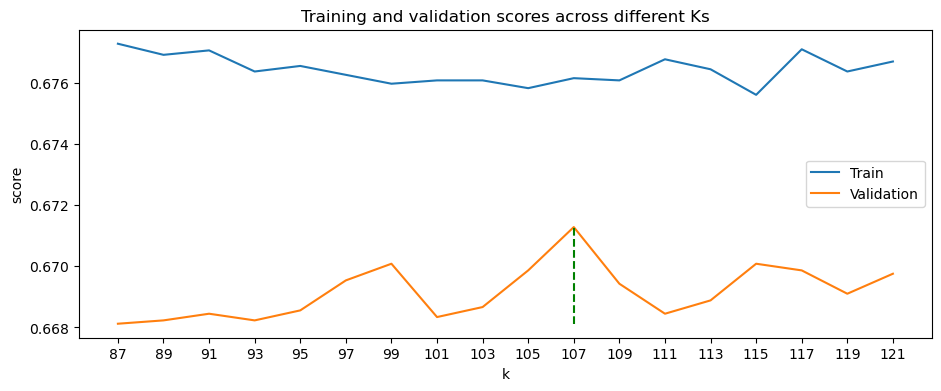

In [59]:
X = pred.drop(['distinct_stores_visited'], axis = 1)
y = pred.distinct_stores_visited

X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                 train_size = 0.75,
                                                 shuffle = True,
                                                 random_state = 15,
                                                 stratify = y)

numberK_list=np.arange(87,122,2)
high_score=0
nof=0
score_list_train =[]
score_list_val =[]
for n in numberK_list:
    model = KNeighborsClassifier(n_neighbors = n).fit(X_train, y_train)
    score_train = model.score(X_train, y_train)
    score_val = model.score(X_val, y_val)
    score_list_train.append(score_train)
    score_list_val.append(score_val)

    if(score_val>high_score):
            high_score = score_val
            nof = n
print("Best number of neighbors: %d" %nof)
print("Mean accuracy in train with %d neighbors: %f" % (nof, score_list_train[numberK_list.tolist().index(nof)]))
print("Mean accuracy in validation with %d neighbors: %f" % (nof, high_score))

fig, ax = plt.subplots(figsize=(11,4))
plt.plot(numberK_list, score_list_train, label='Train')
plt.plot(numberK_list, score_list_val, label = 'Validation')
plt.vlines(x=nof,ymax=high_score,ymin=min(score_list_val),ls='--',colors='g')
plt.xticks(numberK_list)
plt.xlabel('k')
plt.ylabel('score')
plt.legend()
plt.title('Training and validation scores across different Ks')

plt.show()

Imputation on lifetime_spend_vegetables:

Best number of neighbors: 31
Mean accuracy in train with 31 neighbors: 0.687562
Mean accuracy in validation with 31 neighbors: 0.664501


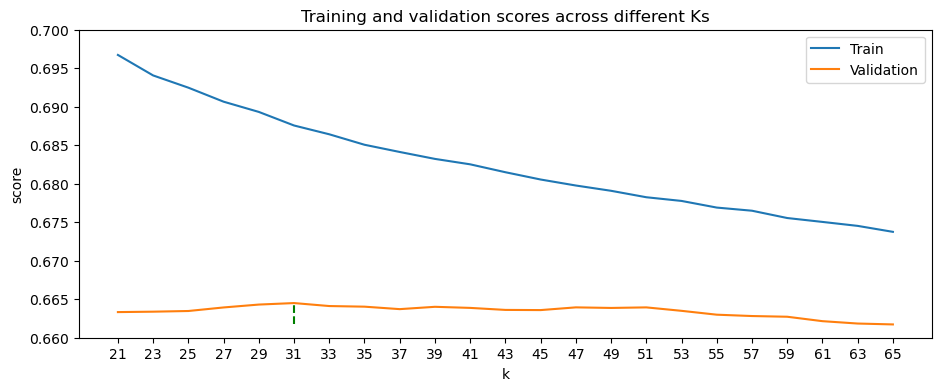

In [60]:
X = pred.drop(['lifetime_spend_vegetables'], axis = 1)
y = pred.lifetime_spend_vegetables

X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                 train_size = 0.75,
                                                 shuffle = True,
                                                 random_state = 15)

numberK_list=np.arange(21,67,2)
high_score=0
nof=0
score_list_train =[]
score_list_val =[]
for n in numberK_list:
    model = KNeighborsRegressor(n_neighbors = n).fit(X_train, y_train)
    score_train = model.score(X_train, y_train)
    score_val = model.score(X_val, y_val)
    score_list_train.append(score_train)
    score_list_val.append(score_val)

    if(score_val>high_score):
            high_score = score_val
            nof = n
print("Best number of neighbors: %d" %nof)
print("Mean accuracy in train with %d neighbors: %f" % (nof, score_list_train[numberK_list.tolist().index(nof)]))
print("Mean accuracy in validation with %d neighbors: %f" % (nof, high_score))

fig, ax = plt.subplots(figsize=(11,4))
plt.plot(numberK_list, score_list_train, label='Train')
plt.plot(numberK_list, score_list_val, label = 'Validation')
plt.vlines(x=nof,ymax=high_score,ymin=min(score_list_val),ls='--',colors='g')
plt.xticks(numberK_list)
plt.ylim(0.66, 0.7)
plt.xlabel('k')
plt.ylabel('score')
plt.legend()
plt.title('Training and validation scores across different Ks')

plt.show()

Imputation on lifetime_spend_fish:

Best number of neighbors: 17
Mean accuracy in train with 17 neighbors: 0.985651
Mean accuracy in validation with 17 neighbors: 0.984416


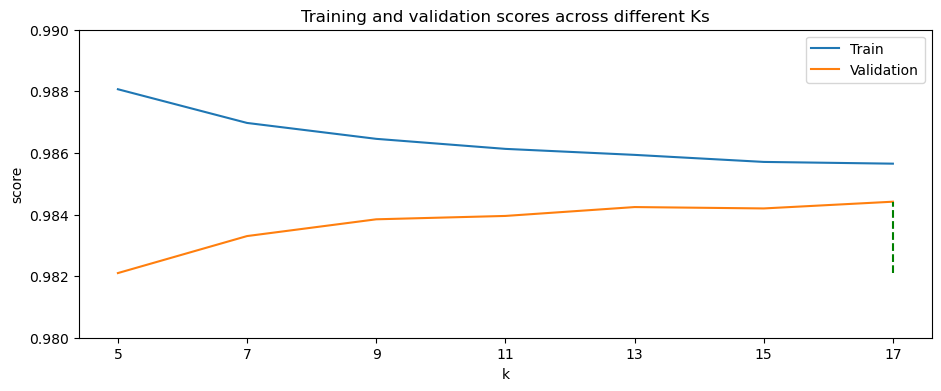

In [61]:
X = pred.drop(['lifetime_spend_fish'], axis = 1)
y = pred.lifetime_spend_fish

X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                 train_size = 0.75,
                                                 shuffle = True,
                                                 random_state = 15)

numberK_list=np.arange(5,18,2)
high_score=0
nof=0
score_list_train =[]
score_list_val =[]
for n in numberK_list:
    model = KNeighborsRegressor(n_neighbors = n).fit(X_train, y_train)
    score_train = model.score(X_train, y_train)
    score_val = model.score(X_val, y_val)
    score_list_train.append(score_train)
    score_list_val.append(score_val)

    if(score_val>high_score):
            high_score = score_val
            nof = n
print("Best number of neighbors: %d" %nof)
print("Mean accuracy in train with %d neighbors: %f" % (nof, score_list_train[numberK_list.tolist().index(nof)]))
print("Mean accuracy in validation with %d neighbors: %f" % (nof, high_score))

fig, ax = plt.subplots(figsize=(11,4))
plt.plot(numberK_list, score_list_train, label='Train')
plt.plot(numberK_list, score_list_val, label = 'Validation')
plt.vlines(x=nof,ymax=high_score,ymin=min(score_list_val),ls='--',colors='g')
plt.xticks(numberK_list)
plt.xlabel('k')
plt.ylim(0.98, 0.99)
plt.ylabel('score')
plt.legend()
plt.title('Training and validation scores across different Ks')

plt.show()

Summary of the imputation on every feature:

In [133]:
data = {'train_score':[0.722259, 0.718368, 0.671939, 0.291499,  0.676156, 0.687562, 0.985651],
        'val_score':[0.712510, 0.696041, 0.657651, 0.258162, 0.671284, 0.664501, 0.984416],
        'optimal_k':[85, 61, 65, 63, 107, 31, 17]}


data = pd.DataFrame(data, index=['kids_home', 'teens_home', 'number_complaints', 'typical_hour',
                          'distinct_stores_visited','lifetime_spend_vegetables', 'lifetime_spend_fish'])
data

,train_score,val_score,optimal_k
kids_home,0.722259,0.712510,85
teens_home,0.718368,0.696041,61
number_complaints,0.671939,0.657651,65
typical_hour,0.291499,0.258162,63
distinct_stores_visited,0.676156,0.671284,107
lifetime_spend_vegetables,0.687562,0.664501,31
lifetime_spend_fish,0.985651,0.984416,17


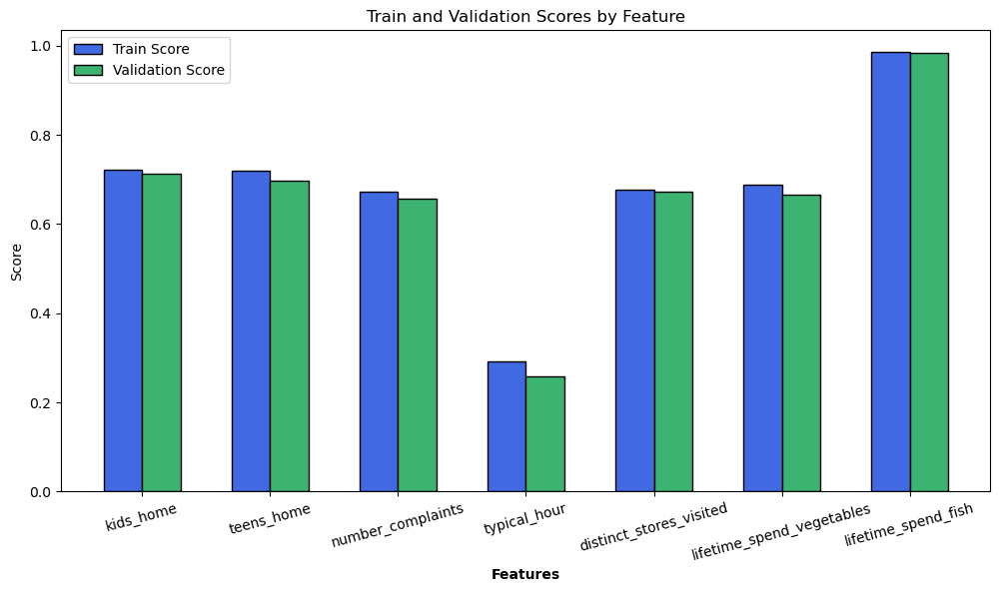

In [69]:
bar_width = 0.3

r1 = np.arange(len(data))
r2 = [x + bar_width for x in r1]

plt.figure(figsize=(12, 6))
plt.bar(r1, data['train_score'], color='royalblue', width=bar_width, edgecolor='black', label='Train Score')
plt.bar(r2, data['val_score'], color='mediumseagreen', width=bar_width, edgecolor='black', label='Validation Score')

plt.xlabel('Features', fontweight='bold')
plt.xticks([r + bar_width / 2 for r in range(len(data))], data.index, rotation=15)

plt.title('Train and Validation Scores by Feature')
plt.ylabel('Score')
plt.legend()

plt.show()


- The imputer of 'lifetime_spend_fish' is almost perfect (suspicious);
- The imputer of 'typical_hour' is horrible;
- The rest have an acceptable/good performance.

Given this, we will drop every missing value on 'typical_hour', since we are not confident that its imputer would yield trustable results.

In [134]:
customer_info_pp = customer_info_pp.dropna(subset=['typical_hour'])

In [135]:
k_per_feature = { feature : k for feature, k in zip( list(data.index), list(data.optimal_k)) }

# initializing the imputer
imputer = KNNImputer()

k_per_feature

{'kids_home': 85,
 'teens_home': 61,
 'number_complaints': 65,
 'typical_hour': 63,
 'distinct_stores_visited': 107,
 'lifetime_spend_vegetables': 31,
 'lifetime_spend_fish': 17}

In [136]:
# iterating over each feature and its number of neighbours
for feature, n_neighbors in k_per_feature.items():
    X_temp = customer_info_pp.copy()

    # creating a mask of the presence of missing values for the current feature
    missing_mask = np.isnan(X_temp[feature])


# if there are missing values in the current feature
    if np.sum(missing_mask) > 0:
        # dropping the target variable of the imputation
        features_to_impute = X_temp.drop(columns=[feature])

        # especifying the number of neighbours and the input
        imputer.n_neighbors = n_neighbors
        imputed_values = imputer.fit_transform(features_to_impute)

        # converting feature name to index if necessary
        if isinstance(feature, str):
            feature_index = X_temp.columns.get_loc(feature)
        else:
            feature_index = feature

        # updating the original dataset with imputed values for the current feature
        X_temp.loc[missing_mask, feature] = imputed_values[:, feature_index][missing_mask]

        customer_info_pp.loc[:,feature] = X_temp.loc[:,feature]

Now we have our dataset with the missing values imputed:

In [67]:
customer_info_pp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 41886 entries, 39634 to 5120
Data columns (total 23 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   lifetime_spend_groceries                 41886 non-null  float64
 1   lifetime_spend_electronics               41886 non-null  float64
 2   lifetime_spend_vegetables                41886 non-null  float64
 3   lifetime_spend_nonalcohol_drinks         41886 non-null  float64
 4   lifetime_spend_alcohol_drinks            41886 non-null  float64
 5   lifetime_spend_meat                      41886 non-null  float64
 6   lifetime_spend_fish                      41886 non-null  float64
 7   lifetime_spend_hygiene                   41886 non-null  float64
 8   lifetime_spend_videogames                41886 non-null  float64
 9   lifetime_spend_petfood                   41886 non-null  float64
 10  lifetime_total_distinct_products         41886 n

#### Feature selection

None of our variables is univariate.

In [68]:
customer_info_pp.var()

lifetime_spend_groceries                   1.083766
lifetime_spend_electronics                 1.637896
lifetime_spend_vegetables                  0.765800
lifetime_spend_nonalcohol_drinks           0.639000
lifetime_spend_alcohol_drinks              1.091534
lifetime_spend_meat                        0.519873
lifetime_spend_fish                        7.778374
lifetime_spend_hygiene                     0.469603
lifetime_spend_videogames                  1.874630
lifetime_spend_petfood                     2.963669
lifetime_total_distinct_products           0.875319
percentage_of_products_bought_promotion    0.903499
year_first_transaction                     0.602140
latitude                                   2.321736
longitude                                  1.001022
age                                        0.316633
typical_hour                               0.423998
kids_home                                  1.298744
teens_home                                 0.698019
number_compl

<Axes: >

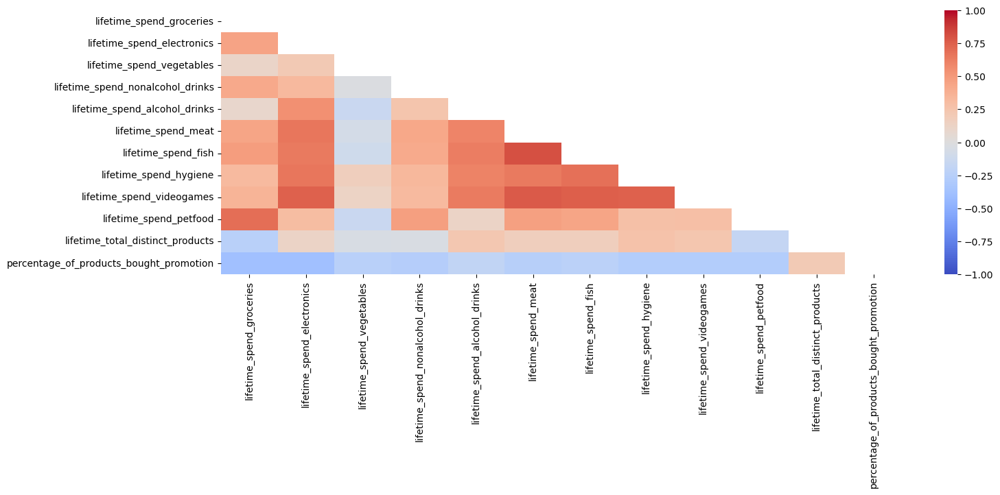

In [71]:
corr = customer_info_pp.drop(['latitude', 'longitude', 'year_first_transaction', 'female', 'loyalty_card_binary',
                                   'distinct_stores_visited', 'teens_home', 'kids_home', 'age', 'number_complaints', 'typical_hour'], axis = 1)
corr = corr.corr(method='spearman')
mask = np.triu(np.ones_like(corr, dtype=bool))
plt.figure(figsize = (16,5))
sns.heatmap(corr, mask=mask, annot=True, fmt=".2f", cmap='coolwarm', vmin=-1, vmax=1,
            xticklabels=corr.columns, yticklabels=corr.columns)


The correlation values disappeared, could not figure out why

Now we can see **high correlations** between some of this categories:

- Videogames and Electronics (which makes sense);
- Videogames and Meat;
- Videogames and Fish;
- Fish and Meat (what also makes sense);
- Petfood and Groceries;
- Hygiene and Fish;
- Eletronics with a lot of categories.

As Videogames is highly correlatated with a lot of categories, it isn't adding much relevant information, so we will remove it from the dataset.




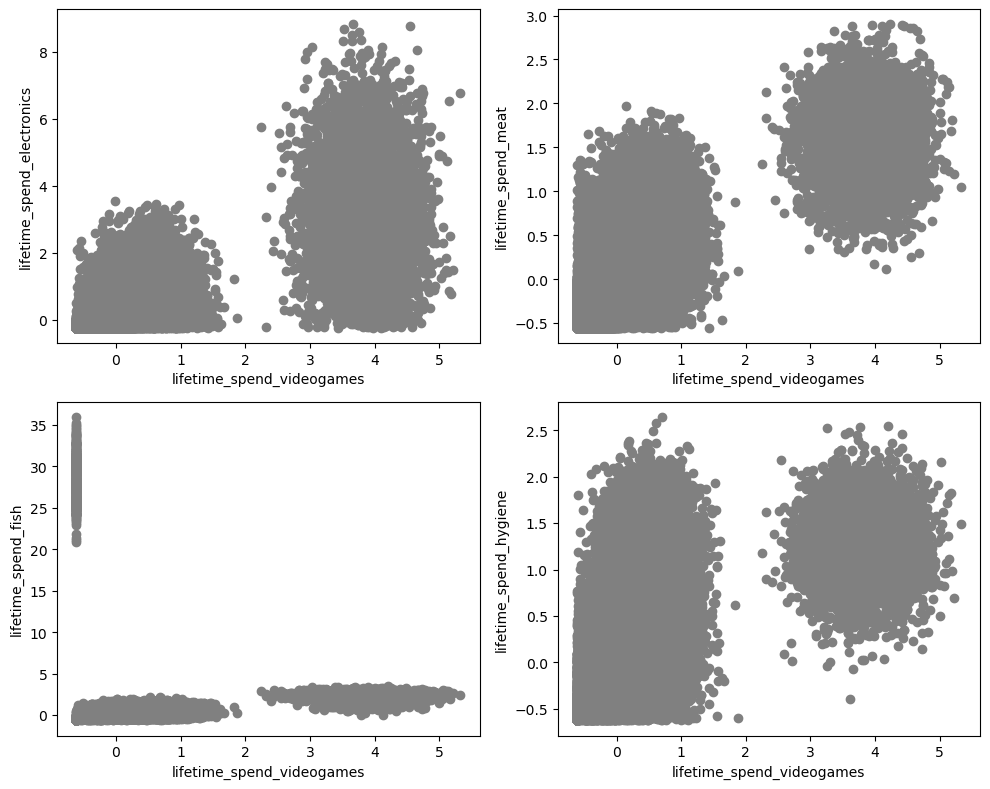

In [72]:
categories = ['lifetime_spend_electronics', 'lifetime_spend_meat', 'lifetime_spend_fish', 'lifetime_spend_hygiene']
fig, axes = plt.subplots(2, 2, figsize=(10, 8))

axes = axes.flatten()

# looping over categories and create scatter plots
for i, category in enumerate(categories):
    axes[i].scatter(customer_info_pp['lifetime_spend_videogames'], customer_info_pp[category], c='grey')
    axes[i].set_xlabel('lifetime_spend_videogames')
    axes[i].set_ylabel(category)

plt.tight_layout()
plt.show()

Re-scaling our dataset without the variable dropped:

In [73]:
customer_info_pp.head(3)

,lifetime_spend_groceries,lifetime_spend_electronics,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,...,latitude,longitude,age,typical_hour,kids_home,teens_home,number_complaints,distinct_stores_visited,loyalty_card_binary,female
customer_id,,,,,,,,,,,,,,,,,,,,,
39634,3.219860,2.782535,0.271709,0.703422,1.243513,1.810840,2.469270,1.414085,3.736494,0.964706,...,-0.413753,0.302882,0.21875,0.571429,1.0,1.0,1.0,2.0,0,0
43460,0.213526,0.323749,-0.120448,-0.171103,1.790419,0.580234,0.928416,1.358685,0.519294,0.654706,...,0.431429,-0.017786,-0.53125,-0.714286,1.0,0.0,1.0,2.0,0,1
23937,-0.220312,1.490522,-0.240896,1.646388,2.816367,-0.080765,1.233550,0.599061,1.044101,0.672941,...,-0.982291,-0.135390,0.06250,-0.428571,0.0,1.0,1.0,3.0,1,1


In [137]:
# Firstly unscaling our scaled dataset

# Numerical features
customer_info_pp_n = customer_info_pp[['lifetime_spend_groceries', 'lifetime_spend_electronics', 'lifetime_spend_vegetables',
                          'lifetime_spend_nonalcohol_drinks', 'lifetime_spend_alcohol_drinks', 'lifetime_spend_meat',
                          'lifetime_spend_fish', 'lifetime_spend_hygiene','lifetime_spend_videogames',
                          'lifetime_spend_petfood', 'lifetime_total_distinct_products', 'percentage_of_products_bought_promotion',
                          'year_first_transaction', 'latitude', 'longitude', 'age', 'typical_hour']]

# Categorical features
customer_info_pp_c = customer_info_pp.loc[:, ~customer_info_pp.columns.isin(customer_info_pp_n.columns)]

# Performing inverse scaling (unscaling) on the numerical
customer_info_pp_n_reversed = pd.DataFrame(scaler.inverse_transform(customer_info_pp_n), columns=customer_info_pp_n.columns, index=customer_info_pp_n.index)
customer_info_pp_n_reversed.columns = customer_info_pp_n.columns

# Merging the reversed numerical features with the categorical features
customer_info_pp = customer_info_pp_n_reversed.join(customer_info_pp_c)

In [138]:
# unscaled
customer_info_pp.head(3)

,lifetime_spend_groceries,lifetime_spend_electronics,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,...,latitude,longitude,age,typical_hour,kids_home,teens_home,number_complaints,distinct_stores_visited,loyalty_card_binary,female
customer_id,,,,,,,,,,,,,,,,,,,,,
39634,18306.0,7106.0,484.0,604.0,943.0,2226.0,4056.0,2174.0,3946.0,2514.0,...,38.735637,-9.149071,59.0,17.0,1.0,1.0,1.0,2.0,0,0
43460,5015.0,1334.0,344.0,374.0,1217.0,1068.0,1925.0,2115.0,1028.0,1987.0,...,38.762702,-9.160802,35.0,8.0,1.0,0.0,1.0,2.0,0,1
23937,3097.0,4073.0,301.0,852.0,1731.0,446.0,2347.0,1306.0,1504.0,2018.0,...,38.717431,-9.165105,54.0,10.0,0.0,1.0,1.0,3.0,1,1


In [139]:
customer_info_pp = customer_info_pp.drop('lifetime_spend_videogames', axis=1)

In [140]:
# Numerical features
cinfo_n = customer_info_pp.loc[:, ['lifetime_spend_groceries', 'lifetime_spend_electronics', 'lifetime_spend_vegetables',
                                      'lifetime_spend_nonalcohol_drinks', 'lifetime_spend_alcohol_drinks', 'lifetime_spend_meat',
                                      'lifetime_spend_fish', 'lifetime_spend_hygiene',
                                      'lifetime_spend_petfood', 'lifetime_total_distinct_products', 'percentage_of_products_bought_promotion',
                                      'year_first_transaction', 'latitude', 'longitude', 'age', 'typical_hour'] ]

# Categorical features
cinfo_c = customer_info_pp.loc[:, ~customer_info_pp.columns.isin(cinfo_n.columns)]

# Creating a new scaler and applying it
new_scaler = RobustScaler().fit(cinfo_n)
scl_cinfo_n = pd.DataFrame(new_scaler.transform(cinfo_n), columns=cinfo_n.columns, index=cinfo_n.index)

# Joining the scaled numerical features with the categorical features
customer_info_pp = scl_cinfo_n.join(cinfo_c)
customer_info_pp.head(3)

,lifetime_spend_groceries,lifetime_spend_electronics,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_petfood,lifetime_total_distinct_products,...,latitude,longitude,age,typical_hour,kids_home,teens_home,number_complaints,distinct_stores_visited,loyalty_card_binary,female
customer_id,,,,,,,,,,,,,,,,,,,,,
39634,3.221204,2.785714,0.273105,0.703422,1.246,1.809777,2.463203,1.415023,0.964706,-0.500000,...,-0.414542,0.303136,0.21875,0.571429,1.0,1.0,1.0,2.0,0,0
43460,0.213510,0.324307,-0.121067,-0.171103,1.794,0.579171,0.925685,1.359624,0.654706,5.259091,...,0.430808,-0.017832,-0.53125,-0.714286,1.0,0.0,1.0,2.0,0,1
23937,-0.220525,1.492324,-0.242134,1.646388,2.822,-0.081828,1.230159,0.600000,0.672941,2.340909,...,-0.983193,-0.135547,0.06250,-0.428571,0.0,1.0,1.0,3.0,1,1


Assigning every product with category 'videogames' to 'electronics', since they are similar enough, and we dont lose information.

In [141]:
product_mapping = product_mapping.replace('videogames', 'electronics')
product_mapping

,category
product_name,
champagne,alcohol_drinks
bramble,alcohol_drinks
white wine,alcohol_drinks
dessert wine,alcohol_drinks
french wine,alcohol_drinks
...,...
final fantasy XX,electronics
final fantasy XIX,electronics
final fantasy XXII,electronics


### Visualizations

**Relation between year of the first transaction and number of distinct products bought:**

In [81]:
rel1 = customer_info_pp[['typical_hour', 'lifetime_total_distinct_products', 'number_complaints']]
sum_products_by_hour = rel1.groupby('typical_hour')['lifetime_total_distinct_products'].mean()
sum_complaints_by_hour = rel1.groupby('typical_hour')['number_complaints'].mean()
prod_hour_df = pd.DataFrame(sum_products_by_hour).reset_index()
complaints_hour_df = pd.DataFrame(sum_complaints_by_hour).reset_index()

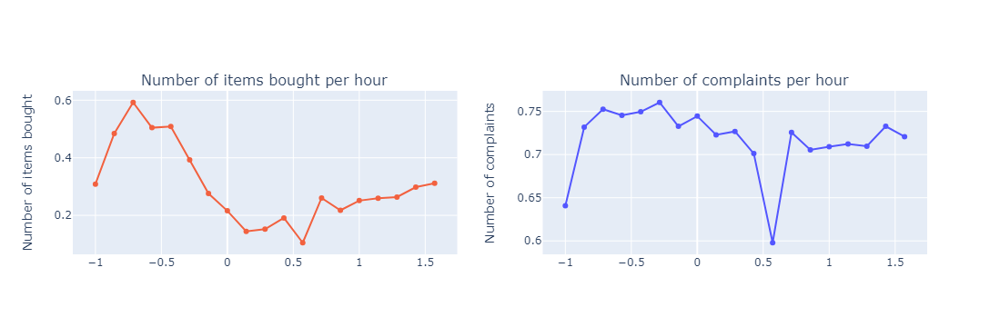

In [82]:
fig1 = make_subplots(rows = 1, cols = 2, subplot_titles = ['Number of items bought per hour', 'Number of complaints per hour'])

x = prod_hour_df['typical_hour']
y1 = prod_hour_df['lifetime_total_distinct_products']
y2 = complaints_hour_df['number_complaints']

fig1.append_trace(go.Scatter(x=x, y=y1, mode='lines+markers', hovertemplate='<i>Nr of items:</i> %{y}<br>' + '<i>Hour:</i> %{x}<extra></extra>',
                             marker=dict(color='#F2613F')), row = 1, col = 1)
fig1.append_trace(go.Scatter(x=x, y=y2, mode = 'lines+markers', hovertemplate='<i>Nr of complaints:</i> %{y}<br>' + '<i>Hour:</i> %{x}<extra></extra>',
                             marker=dict(color='#5356FF')), row = 1, col = 2)

fig1.update_yaxes(title_text = 'Number of items bought', row = 1, col = 1)
fig1.update_yaxes(title_text = 'Number of complaints', row = 1, col = 2)

fig1.update_layout(showlegend=False)


fig1.show()

By looking at both graphs we can see that 'lifetime_total_distinct_products' and 'number_complaints' are slightly correlated. Both reach a peak on hour 8, and a trough on hour 17. 
If we did some kind of morning promotion, that would help to decrease the number of complaints.

**Relation between the lifetime spendings and the use a loyalty card:**

In [83]:
rel3 = customer_info_pp[['loyalty_card_binary', 'lifetime_spend_groceries','lifetime_spend_electronics', 'lifetime_spend_vegetables', 'lifetime_spend_nonalcohol_drinks',
                      'lifetime_spend_alcohol_drinks', 'lifetime_spend_meat', 'lifetime_spend_fish', 'lifetime_spend_hygiene',
                      'lifetime_spend_petfood']]

In [84]:
card_usage = rel3.groupby('loyalty_card_binary')[['lifetime_spend_groceries', 'lifetime_spend_electronics', 'lifetime_spend_vegetables',
                                                  'lifetime_spend_nonalcohol_drinks','lifetime_spend_alcohol_drinks','lifetime_spend_meat',
                                                  'lifetime_spend_fish','lifetime_spend_hygiene',
                                                  'lifetime_spend_petfood']].mean().reset_index()

card_usage['loyalty_card_binary'] = card_usage['loyalty_card_binary'].replace({0: 'No', 1: 'Yes'})
card_usage['loyalty_card_binary'] = card_usage['loyalty_card_binary'].astype(str)

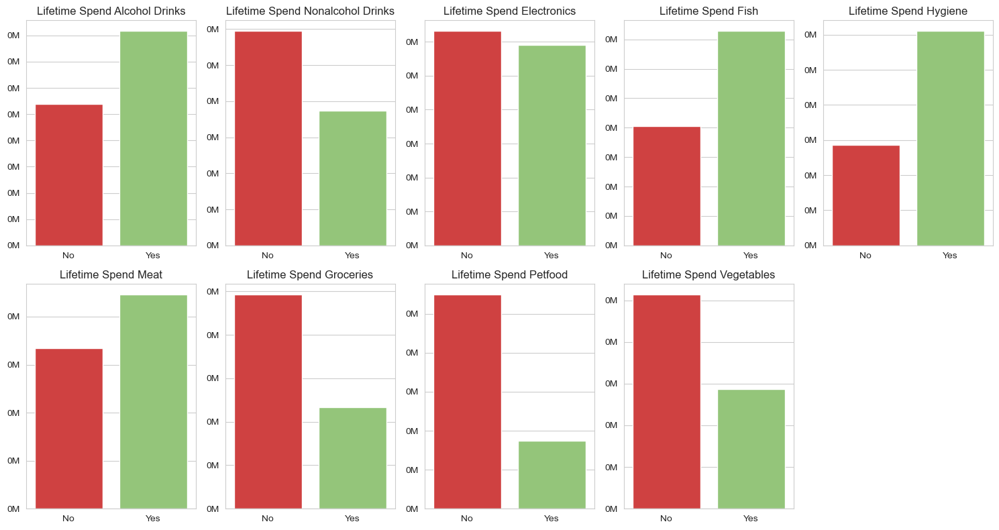

In [85]:
# Set the color palette
colors = ['#E72929', '#90D26D']

# Define the figure and axes
plt.figure(figsize=(15, 8))
sns.set_style("whitegrid")
ax = plt.subplot(2, 5, 1)

# Iterate through each category and create a bar plot
categories = ['lifetime_spend_alcohol_drinks', 'lifetime_spend_nonalcohol_drinks', 'lifetime_spend_electronics',
              'lifetime_spend_fish', 'lifetime_spend_hygiene', 'lifetime_spend_meat', 'lifetime_spend_groceries',
              'lifetime_spend_petfood', 'lifetime_spend_vegetables']

for i, category in enumerate(categories, start=1):
    plt.subplot(2, 5, i)
    sns.barplot(x='loyalty_card_binary', y=category, data=card_usage, palette=colors)
    plt.title(category.replace('_', ' ').title())
    plt.xlabel('')
    plt.ylabel('')

    # Format y-axis labels to be in millions
    plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:.0f}M'.format(x / 1e6)))

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()



By looking to each category we can see that the value spent is not that influenced by the card usage, ultimately depending on the category.
For instance, categories like fish, alcohol drinks or hygiene, are most appreciated by card users. On the other side, spending on categories like groceries, petfood and vegetables does not depend on the loyalty card This might be because the loyalty card does not bring benefits to the customers of that products, which might be a good category to implement some kind of promotion using the loyalty card.

**Relation between the number of complaints and gender and age:**

In [86]:
rel4 = customer_info[['number_complaints', 'customer_gender', 'customer_birthdate']]
rel4['customer_birthdate'] = rel4['customer_birthdate'].apply(lambda x: x[:10])
rel4['age'] = rel4['customer_birthdate'].apply(calculate_age)
rel4.drop('customer_birthdate', axis=1, inplace=True)


rel4['age_group'] = pd.cut(rel4['age'], bins=range(20, 100, 10), labels=[f'{i}-{i+9}' for i in range(20, 90, 10)])

rel4_agegroup_counts = pd.DataFrame(rel4.reset_index().groupby('age_group')['customer_id'].nunique())

C:\Users\tomas\AppData\Local\Temp\ipykernel_11788\3966670029.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\tomas\AppData\Local\Temp\ipykernel_11788\3966670029.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\tomas\AppData\Local\Temp\ipykernel_11788\3966670029.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-v

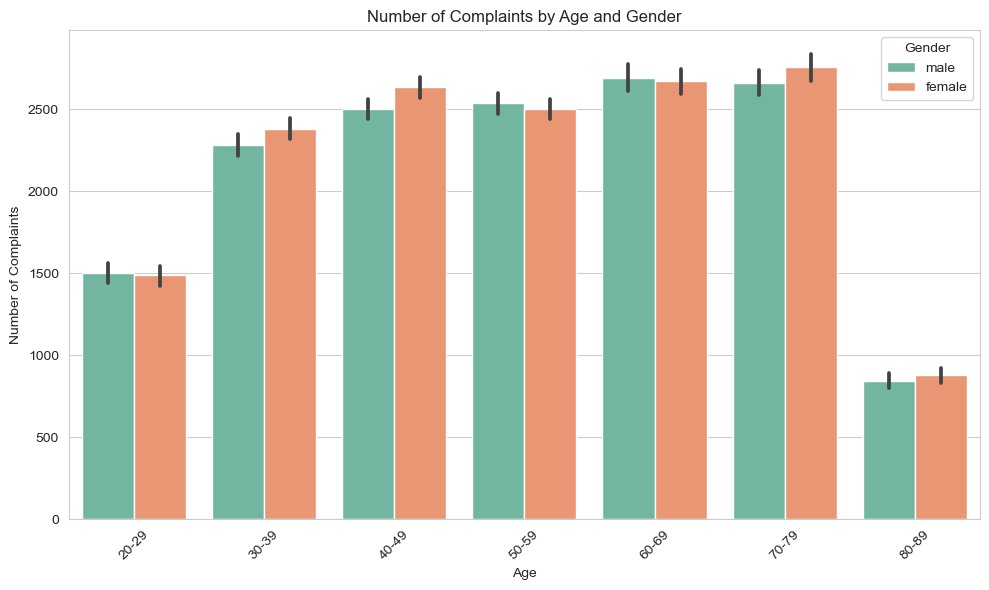

In [87]:
# Plotting the bar plot
plt.figure(figsize=(10, 6))
sns.barplot(data=rel4, estimator='sum',x='age_group', y='number_complaints', hue='customer_gender', palette='Set2')
plt.title('Number of Complaints by Age and Gender')
plt.xlabel('Age')
plt.ylabel('Number of Complaints')
plt.legend(title='Gender')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

By looking at this barplot, we can say that the age groups between the **30 and the 79** have a **lot more complaints** than the **20-29** and the **80-89**. However, we are **not** taking into account the **number of customers** in each age group.



- Let's see the number of customers that there are in each age group:



In [88]:
total_customers_by_age = rel4_agegroup_counts.groupby('age_group')['customer_id'].sum()
total_customers_by_age.name = 'number_of_customers'

We can see that the age groups between 20-29 and 80-89 have less customers than the other groups, then it would be normal to have less complaints in that ages.

In [89]:
# Merging total number of customers with the original DataFrame
rel4 = rel4.merge(total_customers_by_age, on='age_group')
rel4['complaint_density'] = (rel4['number_complaints'] / rel4['number_of_customers']) * 100
rel4

,number_complaints,customer_gender,age,age_group,number_of_customers,complaint_density
0,1.0,male,59,50-59,6849,0.014601
1,1.0,female,54,50-59,6849,0.014601
2,1.0,female,52,50-59,6849,0.014601
3,0.0,female,60,50-59,6849,0.000000
4,1.0,male,52,50-59,6849,0.014601
...,...,...,...,...,...,...
43626,1.0,female,45,40-49,6996,0.014294
43627,1.0,male,50,40-49,6996,0.014294
43628,1.0,female,44,40-49,6996,0.014294
43629,1.0,female,48,40-49,6996,0.014294


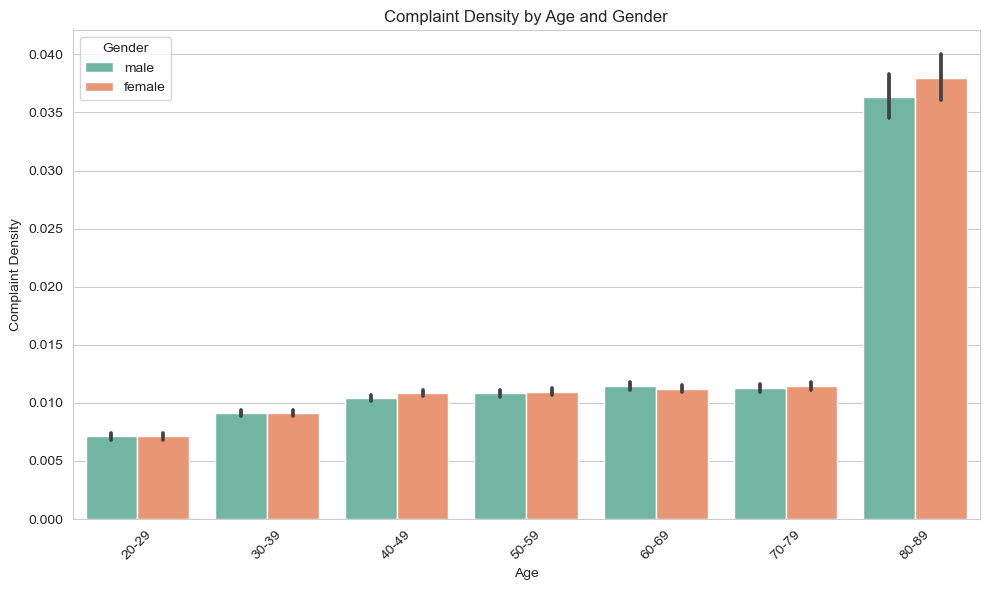

In [90]:
plt.figure(figsize=(10, 6))
sns.barplot(data=rel4, x='age_group', y='complaint_density', hue='customer_gender', palette='Set2')
plt.title('Complaint Density by Age and Gender')
plt.xlabel('Age')
plt.ylabel('Complaint Density')
plt.legend(title='Gender')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Now we can conclude that the customers that are in the age group of the **80-89** have complaint more when we take into account the **number of customers** within the group.

# Customer Segmentation

In [7]:
# Checkpoint on the dataset preprocessed
customer_info_pp = pd.read_csv('checkpoints/customer_info_preprocessed', index_col=0)

## Dimensionality Reduction - Autoencoders

In [8]:
# Creating a copy of our pre-processed dataset, with which we will work further
unlabeled_data = customer_info_pp.sort_index()

Tuning the autoencoder combination of parameters for our problem:

In [80]:
layer_sizes =[ [12, 6], [16, 8] ]        # Different layer sizes to test
encoder_activations = ['relu', 'tanh']   # Different encoder activation functions to test
decoder_activations = ['relu', 'tanh']   # Different decoder activation functions to test

# The size of our input - the number of features
input_size = unlabeled_data.shape[1]

# Creating a dict to store the loss results of each combination
autoencoders = {}

# Iterating over every parameter combination
for ls in layer_sizes:
    for enc_act in encoder_activations:
        for dec_act in decoder_activations:

            # Defining our input layer
            input_layer = Input(shape=(input_size,))

            # Defining our encoding layer
            encoding_layer = Dense(ls[0], activation=enc_act)(input_layer)

            # Defining our code
            code = Dense(ls[1], activation=enc_act)(encoding_layer)

            # Defining our decoding layer
            decoding_layer = Dense(ls[0], activation=dec_act)(code)

            # And our output
            output_data = Dense(input_size, activation='linear')(decoding_layer)
            
            autoencoder = Model(inputs=input_layer, outputs=output_data)
            autoencoder.compile(optimizer='adam', loss='mse')

            # Training the autoencoder
            autoencoder_train = autoencoder.fit(unlabeled_data, unlabeled_data,
                                        epochs=40,
                                        batch_size=16,
                                        shuffle=True)
    
            tuple_key = (tuple(ls), enc_act, dec_act)
            # Add the results to the dictionary
            autoencoders[tuple_key] = autoencoder_train
            print(ls, enc_act, dec_act)

Epoch 1/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 4s 949us/step - loss: 0.7713
Epoch 2/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 977us/step - loss: 0.2658
Epoch 3/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 951us/step - loss: 0.2351
Epoch 4/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 935us/step - loss: 0.2215
Epoch 5/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 859us/step - loss: 0.2132
Epoch 6/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 981us/step - loss: 0.2079
Epoch 7/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - loss: 0.2035
Epoch 8/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 929us/step - loss: 0.2005
Epoch 9/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 963us/step - loss: 0.1959
Epoch 10/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 950us/step - loss: 0.1943
Epoch 11/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 876us/step - loss: 0.1931
Epoch 12/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step - loss: 0.1923
Epoch 13/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 982us/step - loss: 0.1899
Epoch 14/40
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 915us/step - loss: 0.1885
Epoch

Plotting our results:

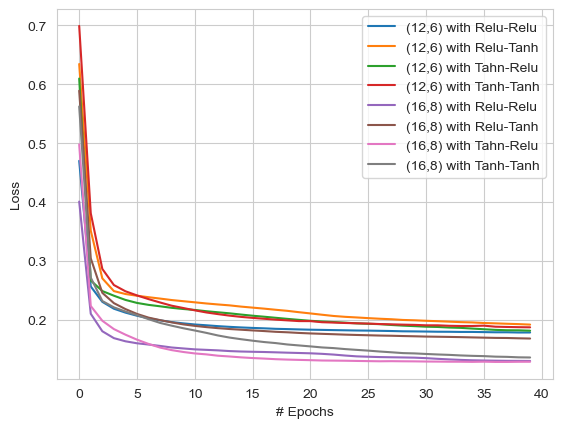

In [82]:
plt.plot(
    autoencoders[(12,6), 'relu', 'relu'].history['loss'])
plt.plot(
    autoencoders[(12,6), 'relu', 'tanh'].history['loss'])
plt.plot(
    autoencoders[(12,6), 'tanh', 'relu'].history['loss'])
plt.plot(
    autoencoders[(12,6), 'tanh', 'tanh'].history['loss'])

plt.plot(
    autoencoders[(16,8), 'relu', 'relu'].history['loss'])
plt.plot(
    autoencoders[(16,8), 'relu', 'tanh'].history['loss'])
plt.plot(
    autoencoders[(16,8), 'tanh', 'relu'].history['loss'])
plt.plot(
    autoencoders[(16,8), 'tanh', 'tanh'].history['loss'])


plt.legend(['(12,6) with Relu-Relu', '(12,6) with Relu-Tanh',
           '(12,6) with Tahn-Relu', '(12,6) with Tanh-Tanh',
           '(16,8) with Relu-Relu', '(16,8) with Relu-Tanh',
           '(16,8) with Tahn-Relu', '(16,8) with Tanh-Tanh'], loc='best', bbox_to_anchor=(1, 1))

plt.title('Autoencoder performance of different parameter combinations')
plt.xlabel('# Epochs')
plt.ylabel('Loss')
plt.show()

In [151]:
#Final autoencoder:

# Here we applied the autoencoder with the combination of parameters that gave us the best result above
input_size = unlabeled_data.shape[1]
input_layer = Input(shape=(input_size,))

# Encoding
encoding_layer = Dense(16, activation='tanh')(input_layer)

code = Dense(8, activation='tanh')(encoding_layer)
encoder = Model(inputs=input_layer, outputs=code)

# Decoding
decoding_layer = Dense(16, activation='relu')(code)
output_layer = Dense(input_size, activation='linear')(decoding_layer)

autoencoder = Model(inputs=input_layer, outputs=output_layer)

# Compile the autoencoder
autoencoder.compile(optimizer='adam', loss='mse')
autoencoder.fit(unlabeled_data, unlabeled_data, epochs=100, batch_size=16, shuffle=True)

encoded_data = encoder.predict(unlabeled_data)

Epoch 1/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 4s 996us/step - loss: 0.7552
Epoch 2/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 935us/step - loss: 0.2348
Epoch 3/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 960us/step - loss: 0.2064
Epoch 4/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 925us/step - loss: 0.1941
Epoch 5/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 885us/step - loss: 0.1855
Epoch 6/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 878us/step - loss: 0.1765
Epoch 7/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 965us/step - loss: 0.1648
Epoch 8/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 955us/step - loss: 0.1567
Epoch 9/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 926us/step - loss: 0.1524
Epoch 10/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 888us/step - loss: 0.1492
Epoch 11/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 931us/step - loss: 0.1463
Epoch 12/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 945us/step - loss: 0.1463
Epoch 13/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 3s 972us/step - loss: 0.1457
Epoch 14/100
2618/2618 ━━━━━━━━━━━━━━━━━━━━ 2s 922us/step - 

In [152]:
reduced_data = pd.DataFrame(encoded_data, index=unlabeled_data.index)

In order to avoid running the parameter search anytime we wanted to work with the notebook, we exported our results to a csv file, to now just import it when needed.

In [3]:
# Reduced dataset used, has everytime the search runs it gives a different one (not sure if there was a random_state parameter available:
reduced_data = pd.read_csv("checkpoints/reduced_data", index_col=0)

In [4]:
reduced_data.head()

,0,1,2,3,4,5,6,7
customer_id,,,,,,,,
1,-0.170380,-0.413198,0.278280,0.538463,-0.224180,0.050932,-0.331731,-0.404203
2,-0.297650,-0.294473,0.260131,0.508247,-0.234842,0.074511,-0.131780,-0.383888
3,0.122580,0.418389,0.367362,-0.422037,-0.093631,-0.020566,-0.201034,-0.300134
4,0.131969,-0.020322,0.234295,0.334527,-0.015353,0.149676,-0.005594,-0.068531
5,0.267670,0.300713,0.289513,0.009943,0.202103,0.000618,-0.010756,0.259230


Seeing until where is worth it to train the SOM:

  2%|▏         | 19/999 [00:08<07:23,  2.21it/s]C:\Users\tomas\anaconda3\Lib\site-packages\minisom.py:540: RuntimeWarning:

invalid value encountered in sqrt

100%|██████████| 999/999 [09:03<00:00,  1.84it/s]


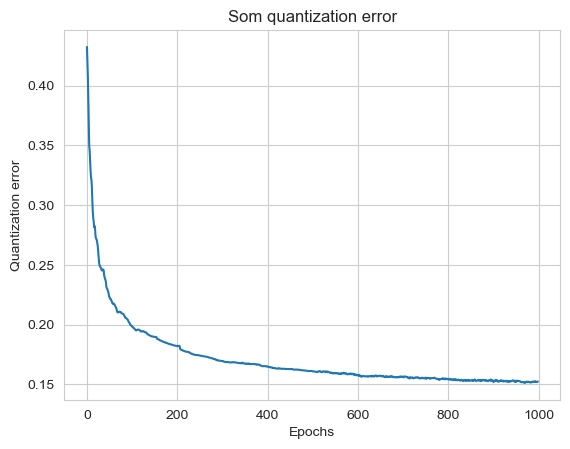

In [284]:
som = MiniSom(  30,
                30,
                8,
                sigma=1.5,
                learning_rate=1.5,
                neighborhood_function='gaussian',
                random_seed=24  )

q_errors = []
for i in trange(1, 1000):
    som.train_batch(reduced_data.values, i)
    q_errors.append(som.quantization_error(reduced_data.values))

plt.plot(q_errors)
plt.title('Som quantization error')
plt.xlabel('Epochs')
plt.ylabel('Quantization error')
plt.show()

## DBSCAN

In [156]:
# Creating a copy of out data to apply the DBSCAN
X_train_dbscan = reduced_data.copy()

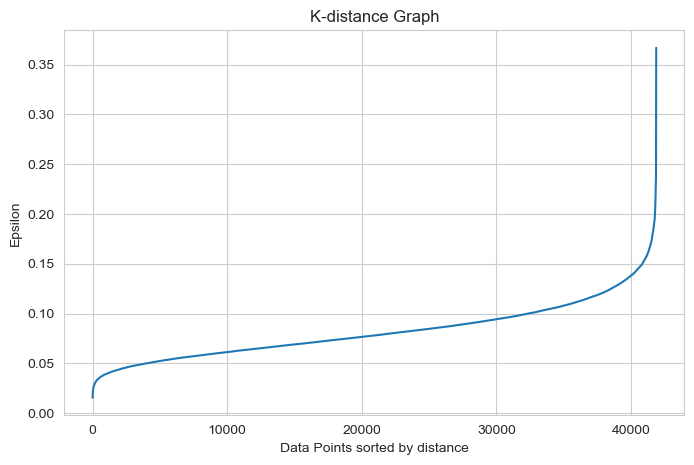

In [157]:
# We considered the 100 nearest neighbours, because we defined minPts as 100. 
# That value seemed reasonable for us since our dataset has over 40k observations
neigh = NearestNeighbors(n_neighbors=100)
nbrs = neigh.fit(X_train_dbscan)
distances, _ = nbrs.kneighbors(X_train_dbscan)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(8,5))
plt.plot(distances)
plt.title('K-distance Graph')
plt.xlabel('Data Points sorted by distance')
plt.ylabel('Epsilon')
plt.show()

In [158]:
# Fitting the DBSCAN with the optimal epsilon
X_train_dbscan['cluster_dbscan'] = DBSCAN(
    eps=0.14, min_samples=100
    ).fit_predict(reduced_data)

In [159]:
X_train_dbscan.cluster_dbscan.value_counts()

cluster_dbscan
-1    25144
 0     6018
 2     5592
 1     1454
 3     1358
 6      778
 4      748
 5      401
 7      393
Name: count, dtype: int64

C:\Users\tomas\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



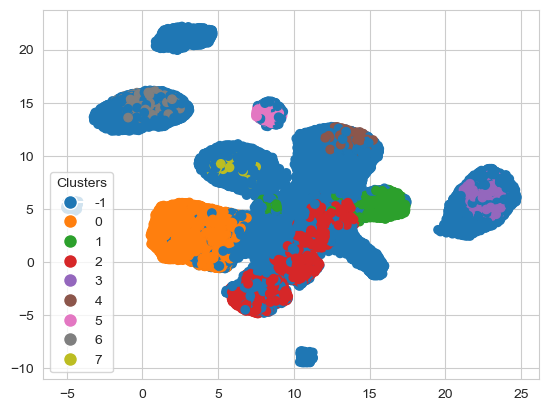

In [160]:
# Dividing our data from the cluster labels
X_dbscan = X_train_dbscan.iloc[:,:-1].sort_index()
y_dbscan = X_train_dbscan.iloc[:,-1].loc[X_dbscan.index]

umap_object = umap.UMAP(n_neighbors=50, min_dist=0.5, random_state=42)
umap_embedding = umap_object.fit_transform(X_dbscan)
visualize_dimensionality_reduction(umap_embedding, y_dbscan)

## Mean Shift

In [5]:
# Creating a copy of our data to apply the Mean Shift algorithm
X_train_ms = reduced_data.copy()

In [6]:
# Estimating the optimal bandwith for the clusters
bandwidth = estimate_bandwidth(X_train_ms, random_state=42)
bandwidth

0.6945300527189919

In [8]:
# Applying the algorithm
ms_model = MeanShift(bandwidth=0.6945, n_jobs=-1, bin_seeding=True)
X_train_ms['cluster_ms'] = ms_model.fit_predict(reduced_data)

C:\Users\tomas\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


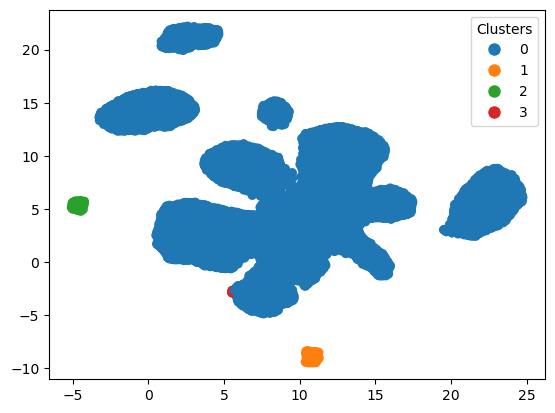

In [10]:
# Dividing our data from the cluster labels
X_ms = X_train_ms.iloc[:,:-1].sort_index()
y_ms = X_train_ms.iloc[:,-1].loc[X_train_ms.index]

umap_object = umap.UMAP(n_neighbors=50, min_dist=0.5, random_state=42)
umap_embedding = umap_object.fit_transform(X_ms)
visualize_dimensionality_reduction(umap_embedding, y_ms)

In [11]:
y_ms.value_counts()

cluster_ms
0    41513
1      188
2      176
3        9
Name: count, dtype: int64

It splitted our data into 64 clusters! We will ignore its suggestions..

## K-Means Clustering

In [165]:
# Creating a copy of our dimensionality reduced dataset which we will apply k-means
X_train_kmeans = reduced_data.copy()

In [166]:
# Getting the inertia values for each number of clusters
dispersion = []
for k in range(1, 25):
    kmeans = KMeans(n_clusters=k, random_state=42).fit(reduced_data)
    dispersion.append(kmeans.inertia_)

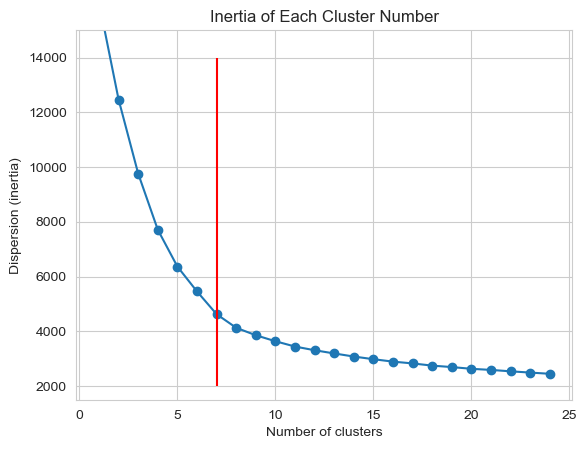

In [167]:
# Plotting it:
plt.plot(range(1, 25), dispersion, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Dispersion (inertia)')

plt.title('Inertia of Each Cluster Number')
plt.vlines(7, 2000, 14000, color='red')
plt.ylim(1500, 15000)
plt.show()

Following the elbow method, the optimal number of clusters is around x-y. We applied with X clusters.

In [168]:
# Training our model for the number of clusters chosen
kmeans = KMeans(n_clusters=7, random_state=42).fit( reduced_data )
X_train_kmeans['cluster_kmeans'] = kmeans.predict( reduced_data )

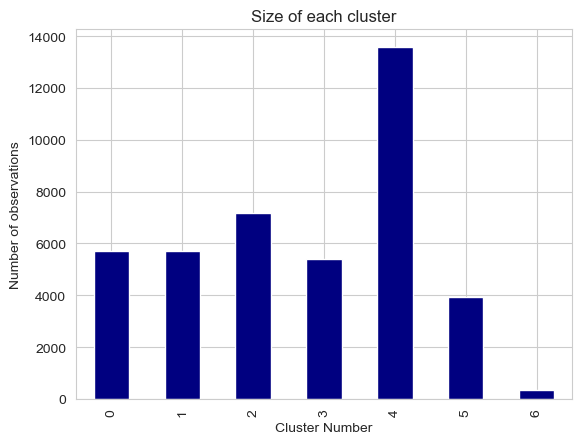

In [169]:
# Size of each cluster
X_train_kmeans.groupby(['cluster_kmeans']).size().plot(kind='bar', color='navy')
plt.title('Size of each cluster')
plt.xlabel('Cluster Number')
plt.ylabel('Number of observations')
plt.show()

Visualizing our clusters:

**U-MAP:**

C:\Users\tomas\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



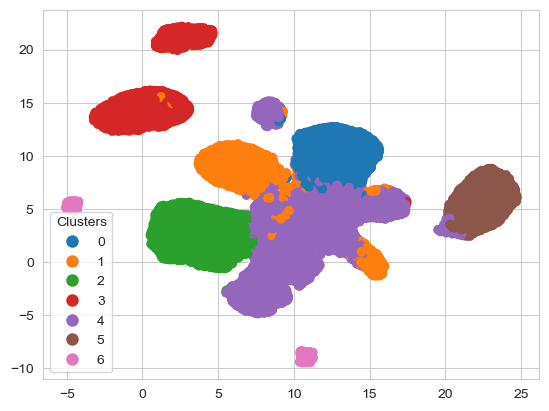

In [170]:
# Splitting the features from the labels
X_km = ( X_train_kmeans.iloc[:,:-1] ).sort_index()
y_km = X_train_kmeans.iloc[:,-1].loc[X_km.index]

# Applying U-MAP, with our parameters
umap_object = umap.UMAP(n_neighbors=50, min_dist=0.5, random_state=42)
umap_embedding = umap_object.fit_transform(X_km)
visualize_dimensionality_reduction(umap_embedding, y_km)

**SOM:**

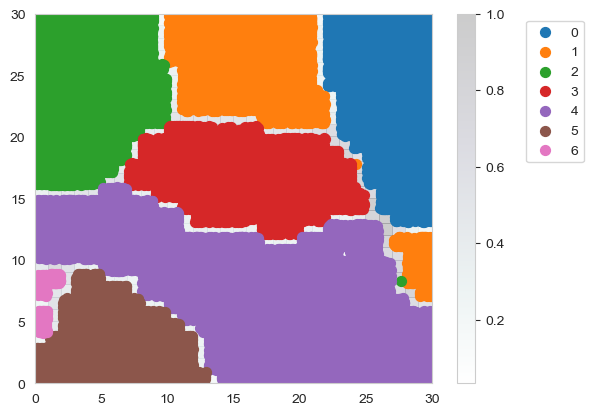

In [171]:
# Defining a SOM object with our parameters
som = MiniSom(  30,
                30,
                9,
                sigma=1.5,
                learning_rate=1.5,
                neighborhood_function='gaussian',
                random_seed=42  )

# Training it over thousands of epochs, since it is very light computationally
som.train(X_train_kmeans.values, 50000)
visualize_data_points_grid(X_train_kmeans, X_train_kmeans.values, som, 'cluster_kmeans')

**Silhouette Score:**

In [172]:
# 0.3632781197900887
silhouette_score(X_km, y_km)

0.3632781197900887

## Hierarchical Clustering

**Single Linkage:**

In [13]:
# Creating a copy of our data to apply HC with the 'single' linkage
X_train_single = reduced_data.copy()

In [278]:
# Estimating the optimal number of clusters:
single_clust = AgglomerativeClustering(
    linkage='single', distance_threshold=0, n_clusters=None
    ).fit(reduced_data)

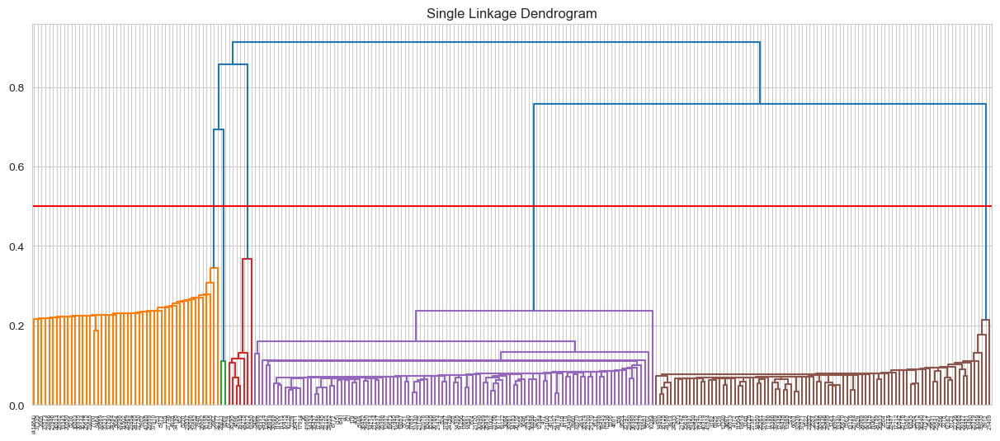

In [280]:
# Visualizing it:
fig, ax = plt.subplots(figsize=(15, 6))
plt.title("Single Linkage Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(single_clust, truncate_mode="level", p=50)
plt.axhline(y = 0.5, color = 'r', linestyle = '-')
plt.show()

By the dendogram above, 5 clusters is the obvious choice.

In [14]:
# Applying the algorithm with 5 clusters, to our data
X_train_single['cluster_single'] = AgglomerativeClustering(linkage='single', n_clusters=5).fit_predict(reduced_data)

**U-MAP:**

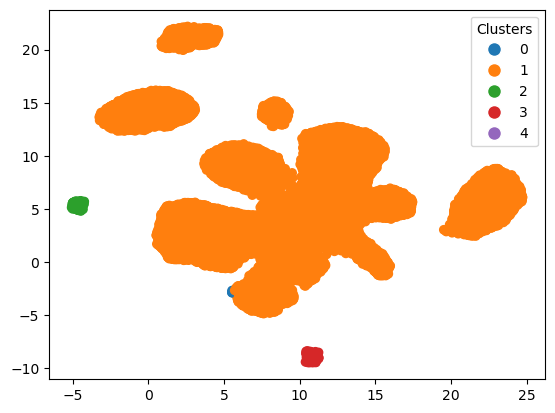

In [15]:
# Splitting the features from the labels
X_single = X_train_single.iloc[:,:-1].sort_index()
y_single = X_train_single.iloc[:,-1].loc[X_single.index]

# Visualizing it with U-MAP
umap_embedding = umap_object.fit_transform(X_single)
visualize_dimensionality_reduction(umap_embedding, y_single)

**Ward's linkage:**

In [173]:
# Creating a copy of our dimensionality reduced dataset which we will apply ward's HC
X_train_ward = reduced_data.copy()

Infering about the optimal number of clusters with the dendogram:

In [94]:
ward_clust = AgglomerativeClustering(
    linkage='ward', distance_threshold=0, n_clusters=None ).fit(reduced_data)

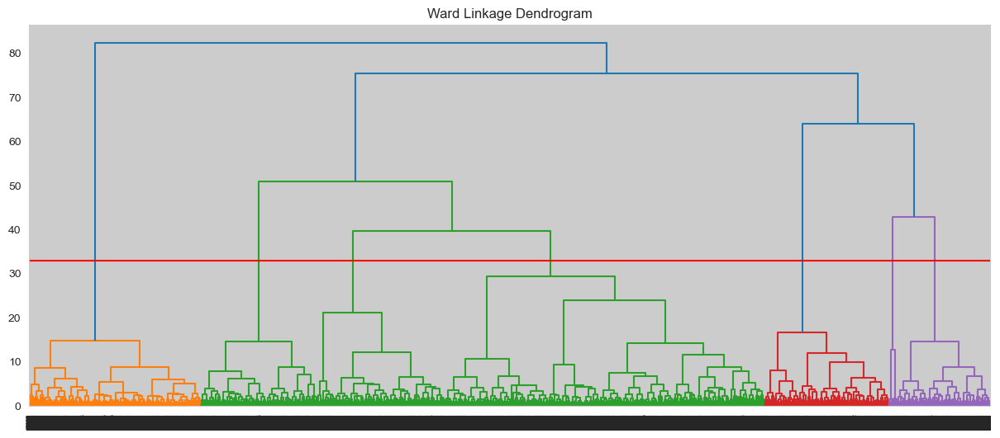

In [95]:
fig, ax = plt.subplots(figsize=(15,6))

plot_dendrogram(ward_clust, truncate_mode="level", p=50)

plt.title("Ward Linkage Dendrogram")
plt.axhline(y = 33, color = 'r', linestyle = '-')
plt.show()

We chose to apply it with 7 clusters, which seems like a good number!

In [174]:
# Applying the cluster with 7 clusters
X_train_ward['cluster_ward'] = AgglomerativeClustering(linkage='ward', n_clusters=7).fit_predict(reduced_data)

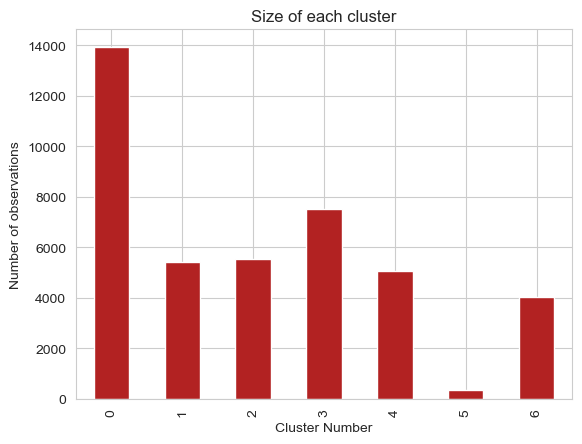

In [175]:
# The size of each cluster on Ward's HC
X_train_ward.groupby(['cluster_ward']).size().plot(kind='bar', color='firebrick')
plt.title('Size of each cluster')
plt.xlabel('Cluster Number')
plt.ylabel('Number of observations')
plt.show()

Visualizing the clusters:

**U-MAP:**

C:\Users\tomas\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



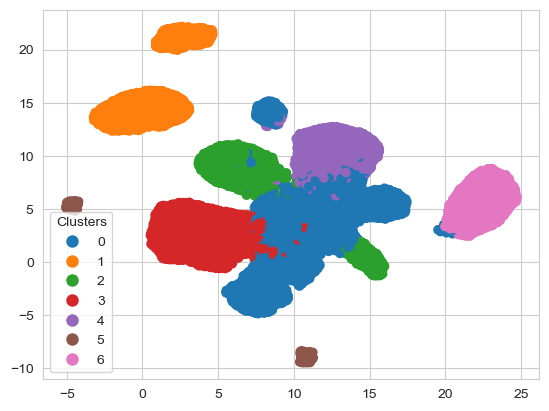

In [176]:
# Splitting the features from the labels
X_ward = X_train_ward.iloc[:,:-1].sort_index()
y_ward = X_train_ward.iloc[:,-1].loc[X_ward.index]

# Applying U-MAP, with our parameters
umap_object = umap.UMAP(n_neighbors=50, min_dist=0.5, random_state=42)
umap_embedding = umap_object.fit_transform(X_ward)
visualize_dimensionality_reduction(umap_embedding, y_ward)

**SOM:**

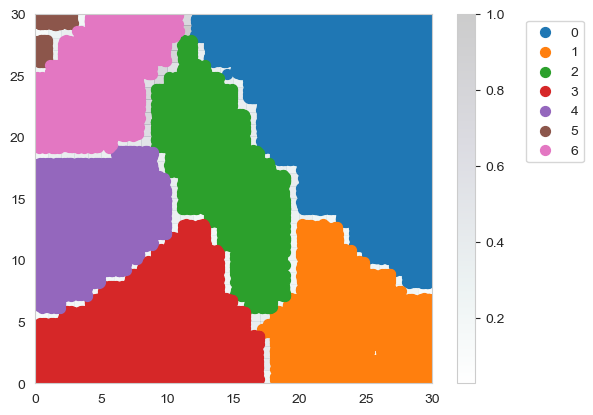

In [177]:
# Defining a SOM object with our parameters
som = MiniSom(  30,
                30,
                9,
                sigma=1.5,
                learning_rate=1.5,
                neighborhood_function='gaussian',
                random_seed=42  )

# Training it over thousands of epochs, since it is very light computationally
som.train(X_train_ward.values, 50000)
visualize_data_points_grid(X_train_ward, X_train_ward.values, som, 'cluster_ward')

**Silhouette Score:**

In [178]:
# 0.35227111108288806
silhouette_score(X_ward, y_ward)

0.35227111108288806

## Final Clustering Solution

Comparing K-Means and Ward, as they had the best results:

In [179]:
# Creating a df only with the cluster suggested to each customer
labels = X_train_ward.join(X_train_kmeans.cluster_kmeans)[['cluster_kmeans','cluster_ward']]
labels.head()

,cluster_kmeans,cluster_ward
customer_id,,
1,2,3
2,2,3
3,3,1
4,4,0
5,1,2


In [11]:
# Checkpoint of the labels of the two best algorithms
labels = pd.read_csv('checkpoints/labels', index_col=0)

In [185]:
# Ward vs. K-Means:
pd.DataFrame(
    confusion_matrix(labels.cluster_kmeans, 
                     labels.cluster_ward),
    index = ['K-means {} Cluster'.format(i) for i in np.arange(0,7)],
    columns = ['Ward {} Cluster'.format(i) for i in np.arange(0,7)])

,Ward 0 Cluster,Ward 1 Cluster,Ward 2 Cluster,Ward 3 Cluster,Ward 4 Cluster,Ward 5 Cluster,Ward 6 Cluster
K-means 0 Cluster,749,0,6,4,4957,0,0
K-means 1 Cluster,455,28,5225,0,19,0,0
K-means 2 Cluster,10,0,0,7157,0,0,0
K-means 3 Cluster,6,5379,7,0,0,0,0
K-means 4 Cluster,12716,0,321,343,107,0,96
K-means 5 Cluster,0,0,0,0,0,0,3937
K-means 6 Cluster,0,0,0,0,0,364,0


In [186]:
# Defining our final clusters, basing ourselves in the cluster suggested by K-Means and Ward, while doing some corrections
cluster1_index = labels.loc[ ( ( labels.cluster_kmeans == 3) & (labels.cluster_ward == 1) ) ].index
cluster2_index = labels.loc[ ( labels.cluster_kmeans == 1 ) ].index
cluster3_index = labels.loc[ ( labels.cluster_kmeans == 2 ) ].index
cluster4_index = labels.loc[ ( labels.cluster_kmeans == 0 ) ].index
cluster5_index = labels.loc[ ( labels.cluster_kmeans == 6 ) ].index
cluster6_index = labels.loc[ ( labels.cluster_ward == 6 ) ] .index

In [187]:
# Assigning each point to their final cluster
X_final = reduced_data.copy()
X_final['cluster'] = 0
X_final.loc[cluster1_index, 'cluster'] = 1
X_final.loc[cluster2_index, 'cluster'] = 2
X_final.loc[cluster3_index, 'cluster'] = 3
X_final.loc[cluster4_index, 'cluster'] = 4
X_final.loc[cluster5_index, 'cluster'] = 5
X_final.loc[cluster6_index, 'cluster'] = 6

In [188]:
X_final.cluster.value_counts()

cluster
0    13500
3     7167
2     5727
4     5716
1     5379
6     4033
5      364
Name: count, dtype: int64

Before the transformations:

C:\Users\tomas\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



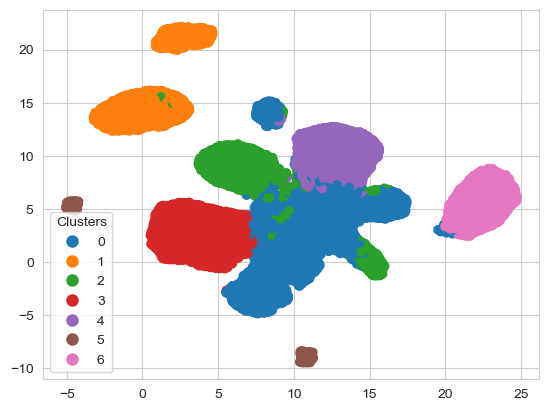

In [195]:
# Splitting the features from the labels
X = X_final.iloc[:,:-1].sort_index()
y = X_final.iloc[:,-1].loc[X.index]

# Creating the U-MAP's object and embedding
umap_object = umap.UMAP(n_neighbors=50, min_dist=0.5, random_state=42)
umap_embedding = umap_object.fit_transform(X)

visualize_dimensionality_reduction(umap_embedding, y)

After the transformations:

C:\Users\tomas\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



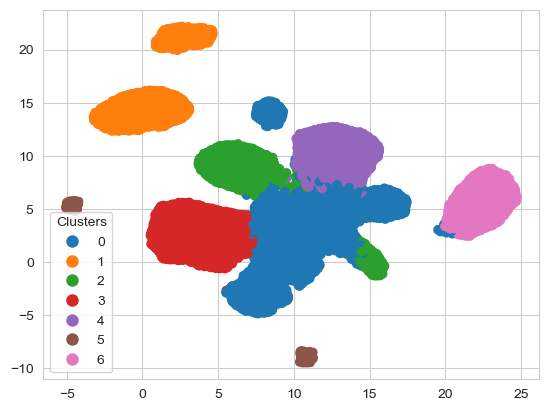

In [196]:
# Creating the U-MAP's object and embedding
umap_object = umap.UMAP(n_neighbors=50, min_dist=0.5, random_state=42)
umap_embedding = umap_object.fit_transform(X)

# Correcting some points, basing ourselves in the U-MAP coordinates and SOM

condition1 = umap_embedding[ ( umap_embedding[:, 0] < 3 ) 
                            & ( umap_embedding[:, 1] < 18 ) & ( umap_embedding[:, 1] > 12 )]
idxs1 = [np.where(np.all(umap_embedding == i, axis=1))[0][0] for i in condition1]
y.iloc[idxs1] = 1

condition3 = umap_embedding[  ( ( umap_embedding[:, 0] < 10 ) 
                             & ( umap_embedding[:, 0] > 6 ) & ( umap_embedding[:, 1] > 12.5 ) )  
                             | ( (umap_embedding[:,0] - 15.5)**2 + (umap_embedding[:, 1] - 7)**2 < 1 )
                             | ( (umap_embedding[:,0] - 9)**2 + (umap_embedding[:, 1] - 5)**2 < 3 )
                             | ( (umap_embedding[:,0] - 9)**2 + (umap_embedding[:, 1] - 2.5)**2 < 2 )]

idxs3 = [np.where(np.all(umap_embedding == i, axis=1))[0][0] for i in condition3]
y.iloc[idxs3] = 0

visualize_dimensionality_reduction(umap_embedding, y)

C:\Users\tomas\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



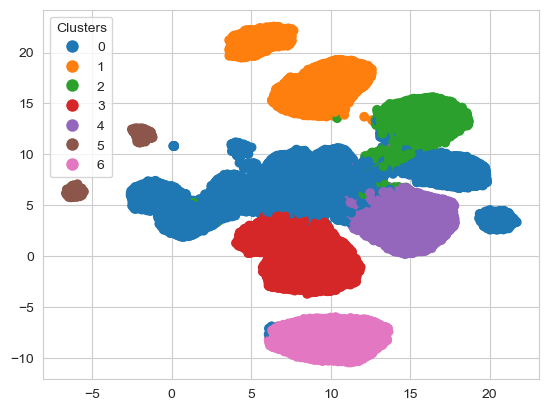

In [154]:
umap_object = umap.UMAP(n_neighbors=15, min_dist=0.5, random_state=42)
umap_embedding = umap_object.fit_transform(X)
visualize_dimensionality_reduction(umap_embedding, y)

C:\Users\tomas\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



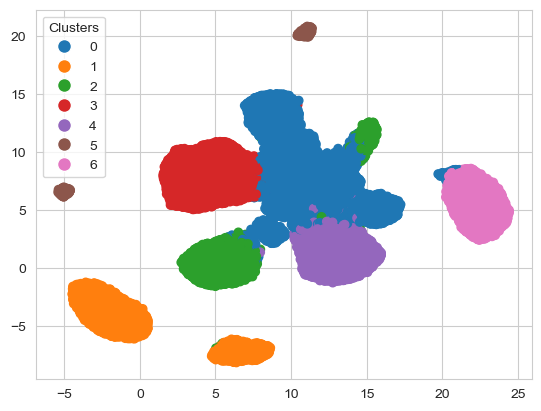

In [155]:
umap_object = umap.UMAP(n_neighbors=85, min_dist=0.5, random_state=42)
umap_embedding = umap_object.fit_transform(X)
visualize_dimensionality_reduction(umap_embedding, y)

In [195]:
silhouette_score(X, y)

0.36327226259376516

**SOM:**

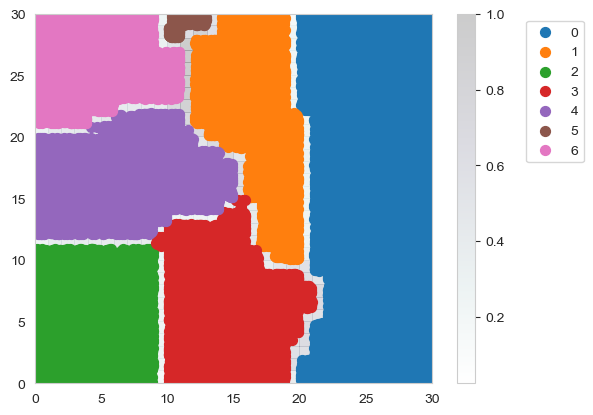

In [139]:
X_final = X_final.sort_index()
X_final.iloc[:,-1] = y

som = MiniSom(
                30,
                30,
                9,
                sigma=1.5,
                learning_rate=1.5,
                neighborhood_function='gaussian',
                random_seed=42  )

som.train(X_final.values, 100000)
visualize_data_points_grid(X_final, X_final.values, som, 'cluster')

## Profiling

In [12]:
def reverse_scaler(dataset):
    """
    Reverses the scaling transformation applied to a dataset's numerical columns, restoring their original values.
    
    Parameters:
    dataset (pandas.DataFrame): The dataset containing both numerical and categorical columns, with the last column (label) to be retained separately.
    
    Returns:
    pandas.DataFrame: The dataset with its numerical columns inverse transformed to their original scale, 
                      concatenated with the categorical columns and the last column.
    
    Process:
    1. Extract the last column from the dataset.
    2. Remove the last column from the main dataset.
    3. Select the numerical columns from the dataset.
    4. Select the categorical columns by excluding the numerical columns.
    5. Perform the inverse transformation on the numerical columns using the pre-fitted scaler.
    6. Merge the reversed numerical columns with the categorical columns.
    7. Concatenate the previously extracted last column back to the dataset.
    
    Note:
    It was unsured that the last column of the dataset was always the label of the cluster.
    """

    
    # Extract the last column
    dataset_last_column = dataset.iloc[:, -1]
    # Remove the last column from the dataset
    dataset = dataset.iloc[:, :-1]
    # Select the numerical columns
    dataset_n = dataset[['lifetime_spend_groceries', 'lifetime_spend_electronics', 'lifetime_spend_vegetables',
                          'lifetime_spend_nonalcohol_drinks', 'lifetime_spend_alcohol_drinks', 'lifetime_spend_meat',
                          'lifetime_spend_fish', 'lifetime_spend_hygiene',
                          'lifetime_spend_petfood', 'lifetime_total_distinct_products', 'percentage_of_products_bought_promotion',
                          'year_first_transaction', 'latitude', 'longitude', 'age', 'typical_hour']]

    # Select the categorical columns
    dataset_c = dataset.loc[:, ~dataset.columns.isin(dataset_n.columns) ]
    
    # Perform inverse transformation on numerical columns
    dataset_n_reversed = pd.DataFrame(new_scaler.inverse_transform(dataset_n), index=dataset_n.index, columns=dataset_n.columns)

    # Merge the reversed numerical columns with the categorical columns
    dataset_reversed_final = dataset_n_reversed.join(dataset_c)
    # Concatenate the last column back
    dataset_reversed_final = pd.concat([dataset_reversed_final, dataset_last_column], axis=1)

    return dataset_reversed_final

In [205]:
labeled_data = unlabeled_data.join(y)

In [225]:
labeled_data[['cluster']].to_csv('Group24_clustersolution')

In [18]:
# Checkpoint
labeled_data = pd.read_csv('checkpoints/labeled_data', index_col=0)

In [14]:
cluster0 = labeled_data.loc[labeled_data.cluster == 0]
cluster1 = labeled_data.loc[labeled_data.cluster == 1]
cluster2 = labeled_data.loc[labeled_data.cluster == 2]
cluster3 = labeled_data.loc[labeled_data.cluster == 3]
cluster4 = labeled_data.loc[labeled_data.cluster == 4]
cluster5 = labeled_data.loc[labeled_data.cluster == 5]
cluster6 = labeled_data.loc[labeled_data.cluster == 6]

clusters = [cluster0, cluster1, cluster2, cluster3, cluster4, cluster5, cluster6]

In [15]:
clusters_means = labeled_data.groupby('cluster').mean()
clusters_means

,lifetime_spend_groceries,lifetime_spend_electronics,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_petfood,lifetime_total_distinct_products,...,latitude,longitude,age,typical_hour,kids_home,teens_home,number_complaints,distinct_stores_visited,loyalty_card_binary,female
cluster,,,,,,,,,,,,,,,,,,,,,
0,-0.289561,0.201041,-0.313885,-0.244578,0.211136,-0.011218,-0.025086,-0.070179,-0.129070,0.380014,...,0.000251,0.092123,-0.084134,0.055549,0.553068,0.817688,0.766063,2.266782,0.641042,0.495741
1,2.252296,3.218348,0.322276,0.675203,1.386366,1.574905,2.388545,1.250160,1.251329,-0.344539,...,0.098820,0.383675,0.075400,0.091205,1.001665,0.985138,0.514550,1.362863,0.497318,0.501387
2,0.115575,0.574860,-0.298488,0.708783,1.705108,0.411616,0.829359,1.091632,0.533340,1.625493,...,-0.100293,0.104051,-0.027995,-0.350009,0.928085,0.742794,0.908327,1.902744,0.763114,0.501587
3,-0.259239,-0.071591,1.755871,-0.419824,-0.327973,-0.500195,-0.415244,-0.159553,-0.220380,-0.090977,...,-0.035184,0.088521,0.072204,0.105214,0.986450,0.450038,0.518686,1.227913,0.486811,0.506071
4,0.210491,0.611354,0.309954,0.315200,-0.040532,0.505701,0.264741,0.307758,0.067371,0.605564,...,-0.000709,0.197426,0.076931,0.664163,3.335422,2.003499,0.989328,1.067999,0.597266,0.513144
5,2.212819,-0.165127,0.025668,-0.418867,-0.440670,-0.467062,28.497066,-0.532624,-0.514118,-0.527404,...,13.039983,-6.524357,0.049794,-0.428179,0.024725,0.035714,0.516484,0.989011,0.804945,0.489011
6,1.379223,-0.176455,-0.514272,0.306163,-0.559125,-0.341071,-0.324797,-0.551940,5.417958,-0.455252,...,-0.010880,-0.373433,0.081104,-0.163756,0.000251,0.022068,0.514009,0.976196,0.200843,0.505579


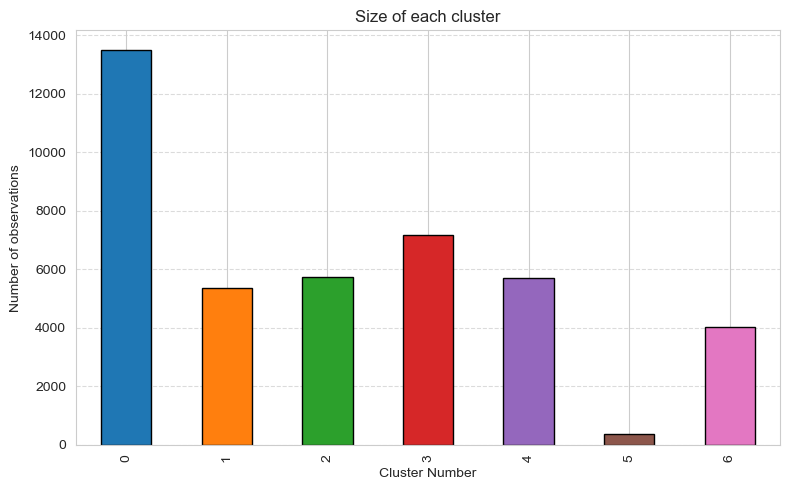

In [223]:
# The size of each cluster on Ward's HC
fig = plt.subplots(figsize=(8,5))
X_final.groupby(['cluster']).size().plot(kind='bar', color=list(TABLEAU_COLORS.values())[:10], edgecolor='black')


plt.title('Size of each cluster')
plt.xlabel('Cluster Number')
plt.ylabel('Number of observations')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

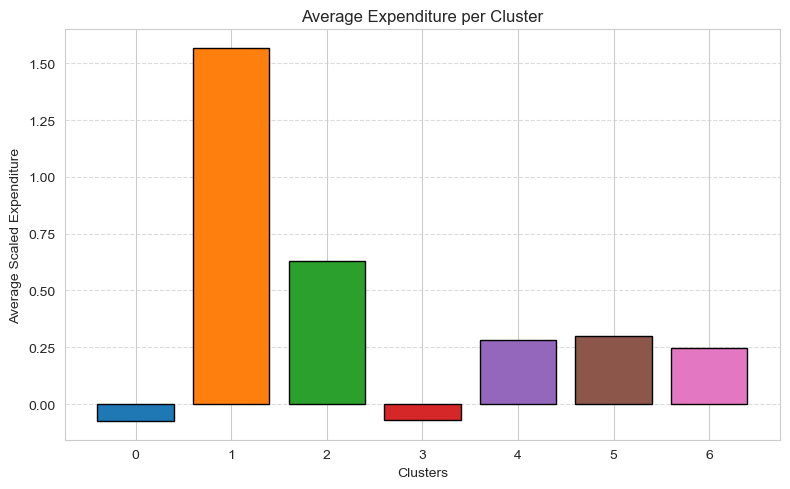

In [224]:
# Filtering to only get the expenditure variables
cluster_expenditure = clusters_means[[col for col in labeled_data.columns if 'lifetime_spend' in col]]
# Winsorizing the extreme outliers, to improve the visualization
cluster_expenditure = cluster_expenditure.applymap(lambda x: 3 if x > 3 else x)

fig = plt.subplots(figsize=(8,5))

plt.bar(cluster_expenditure.index, cluster_expenditure.mean(axis=1), color=list(TABLEAU_COLORS.values())[:8], edgecolor='black')
plt.ylabel('Average Scaled Expenditure')
plt.xlabel('Clusters')
plt.title('Average Expenditure per Cluster')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

In [142]:
# Creating a dataset of our labeled data, but with the original values (reverse scaled)
data_final = reverse_scaler(labeled_data)

cmap = plt.get_cmap('tab10')
colors = [cmap(i) for i in range(cmap.N)]
colors = ['#{:02x}{:02x}{:02x}'.format(int(r*255), int(g*255), int(b*255)) for r, g, b, _ in colors]

unique_clusters = data_final['cluster'].unique()
unique_clusters = sorted(unique_clusters)

cluster_color_map = {cluster: colors[i] for i, cluster in enumerate(unique_clusters)}

# Initialize a map centered around an average location
map = folium.Map(location=[data_final['latitude'].mean(), data_final['longitude'].mean()], zoom_start=5)

# Add points to the map with different colors based on cluster
for idx, row in data_final.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=2,  # Adjust the radius as needed
        color=cluster_color_map[row['cluster']],
        fill=True,
        fill_color=cluster_color_map[row['cluster']],
        fill_opacity=0.6
    ).add_to(map)

map

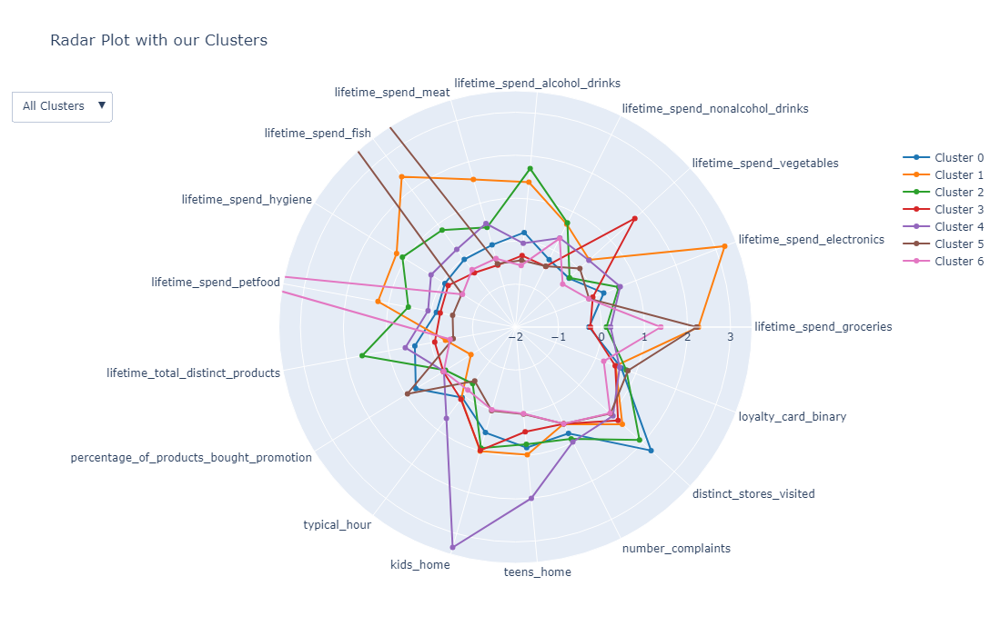

In [143]:
categories = labeled_data.drop(['cluster', 'latitude', 'longitude',
                                 'age', 'year_first_transaction',
                                'female'], axis=1).columns

clusters = labeled_data['cluster'].unique()
clusters = sorted(clusters)

values = []
for cluster in clusters:
    cluster_data = labeled_data[labeled_data['cluster'] == cluster]
    values.append([cluster_data[cat].mean() for cat in categories])

num_vars = len(categories)

colors = list(TABLEAU_COLORS.values())[:10]

# Compute angle for each axis
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]

fig = go.Figure()

for i, cluster_values in enumerate(values):
    cluster_values += cluster_values[:1]  # Ensure the loop is closed
    fig.add_trace(go.Scatterpolar(
        r=cluster_values,
        theta=categories.tolist() + [categories[0]],  # Ensure the loop is closed
        fill='none',
        name=f'Cluster {i}',
        line=dict(color=colors[i]),
        visible=True  
    ))

fig.update_layout(
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[-2, 3.5]
        )),
    showlegend=True,
    title="Radar Plot with our Clusters",
    width=1100,  
    height=700,
        legend=dict(
        orientation="v",  
        yanchor="middle",  
        y=0.75, 
        xanchor="left",  
    )
)

# Add dropdown for cluster selection
buttons = []

buttons.append(dict(
    method='update',
    label='All Clusters',
    args=[{'visible': [True] * len(values)},
          {'title': 'Radar Plot with All Clusters',
           'showlegend': True}]))

for i in range(len(values)):
    visibility = [False] * len(values)
    visibility[i] = True
    buttons.append(dict(
        method='update',
        label=f'Cluster {i}',
        args=[{'visible': visibility},
              {'title': f'Radar Plot for Cluster {i}',
               'showlegend': True}]
    ))

fig.update_layout(
    updatemenus=[dict(
        type="dropdown",
        direction="down",
        buttons=buttons,
        showactive=True,

    )]
)

fig.show()

In [144]:
customer_basket.info()

<class 'pandas.core.frame.DataFrame'>
Index: 89651 entries, 7448187 to 8150061
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   list_of_goods  89651 non-null  object
 1   customer_id    89651 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 4.1+ MB


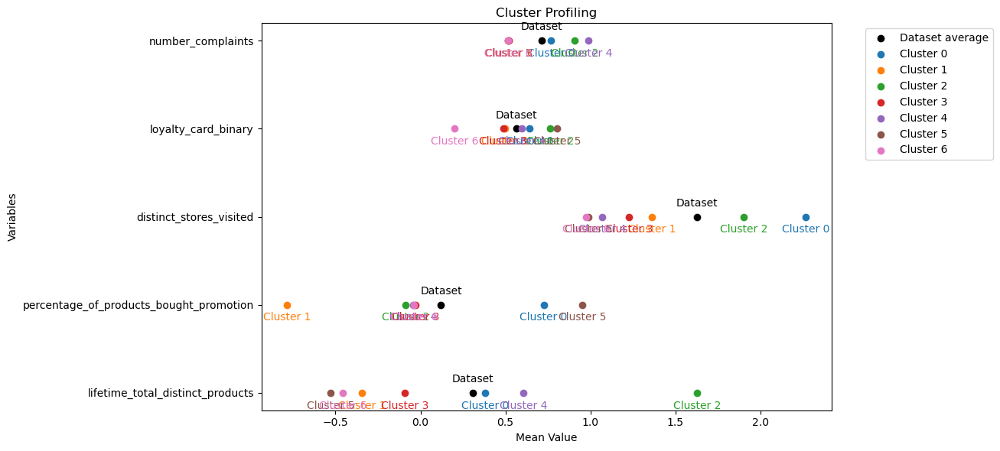

In [145]:
variables = ['lifetime_total_distinct_products', 'percentage_of_products_bought_promotion', 
             'distinct_stores_visited', 'loyalty_card_binary', 'number_complaints']

dataset_averages = [labeled_data[var].mean() for var in variables]

cluster_averages = {
    'Cluster 0': [labeled_data.loc[labeled_data.cluster == 0][var].mean() for var in variables],
    'Cluster 1': [labeled_data.loc[labeled_data.cluster == 1][var].mean() for var in variables],
    'Cluster 2': [labeled_data.loc[labeled_data.cluster == 2][var].mean() for var in variables],
    'Cluster 3': [labeled_data.loc[labeled_data.cluster == 3][var].mean() for var in variables],
    'Cluster 4': [labeled_data.loc[labeled_data.cluster == 4][var].mean() for var in variables],
    'Cluster 5': [labeled_data.loc[labeled_data.cluster == 5][var].mean() for var in variables],
    'Cluster 6': [labeled_data.loc[labeled_data.cluster == 6][var].mean() for var in variables],
}

colors = list(TABLEAU_COLORS.values())[:8]

# Creating the scatter plot
fig, ax = plt.subplots(figsize=(18, 6))

# Scatter plot for dataset averages
ax.scatter(dataset_averages, variables, color='black', label='Dataset average')

# Scatter plot for each cluster averages
for i, (cluster, averages) in enumerate(cluster_averages.items()):
    ax.scatter(averages, variables, color=colors[i], label=cluster)

# Annotating points
for i, var in enumerate(variables):
    ax.annotate('Dataset', (float(dataset_averages[i]), var), textcoords="offset points", xytext=(0, 10), ha='center', color='black')
    for j, (cluster, averages) in enumerate(cluster_averages.items()):
        ax.annotate(cluster, (float(averages[i]), var), textcoords="offset points", xytext=(0, -15), ha='center', color=colors[j])

ax.set_xlabel('Mean Value')
ax.set_ylabel('Variables')
ax.set_title('Cluster Profiling')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.75, 1])

plt.show()

The lines of each variable in the plot above disappeared

In [146]:
pd.set_option('display.max_columns', None)
reverse_scaler( clusters_means )

,lifetime_spend_groceries,lifetime_spend_electronics,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,latitude,longitude,age,typical_hour,kids_home,teens_home,number_complaints,distinct_stores_visited,loyalty_card_binary,female
cluster,,,,,,,,,,,,,,,,,,,,,,
0,2791.929840,1044.940234,275.515765,354.675906,425.568211,512.443554,607.231255,592.259203,6.545808e+02,419.206366,0.349814,2012.261008,38.748917,-9.156783,49.307709,13.388841,0.553068,0.817688,0.766063,2.266782,0.641042,0.495741
1,14024.394674,8120.526910,501.464182,596.578509,1013.183096,2004.985204,3952.523584,1998.420011,3.001260e+03,100.402626,0.049306,2011.144442,38.752073,-9.146127,54.412798,13.638432,1.001665,0.985138,0.514550,1.362863,0.497318,0.501387
2,4582.226993,1921.547508,280.984688,605.409931,1172.554041,910.330782,1791.492073,1829.588389,1.780679e+03,967.216912,0.187843,2009.970879,38.745698,-9.156347,51.104163,10.549935,0.928085,0.742794,0.908327,1.902744,0.763114,0.501587
3,2925.923936,405.619958,1010.641340,308.586183,156.013538,52.316678,66.471562,497.075645,4.993539e+02,211.970133,0.199780,2011.123936,38.747783,-9.156915,54.310537,13.736497,0.986450,0.450038,0.518686,1.227913,0.486811,0.506071
4,5001.660007,2007.126008,497.087958,501.897652,299.734140,998.864178,1008.931428,994.762355,9.885303e+02,518.447950,0.196699,2011.095864,38.748887,-9.152935,54.461795,17.649141,3.335422,2.003499,0.989328,1.067999,0.597266,0.513144
5,13849.947802,186.277473,396.116805,308.837912,99.664835,83.494505,40138.934066,99.755495,-1.136868e-13,19.942308,0.395271,2011.280220,39.166404,-9.398616,53.593407,10.002747,0.024725,0.035714,0.516484,0.989011,0.804945,0.489011
6,10166.285891,159.713117,204.343438,499.520952,40.437639,202.051822,191.831410,79.184230,1.008453e+04,51.689065,0.198039,2011.044880,38.748561,-9.173800,54.595338,11.853707,0.000251,0.022068,0.514009,0.976196,0.200843,0.505579


In [147]:
reverse_scaler( clusters_means ).rank()

,lifetime_spend_groceries,lifetime_spend_electronics,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,latitude,longitude,age,typical_hour,kids_home,teens_home,number_complaints,distinct_stores_visited,loyalty_card_binary,female
cluster,,,,,,,,,,,,,,,,,,,,,,
0,1.0,4.0,2.0,3.0,5.0,4.0,3.0,4.0,3.0,5.0,6.0,7.0,5.0,4.0,1.0,4.0,3.0,5.0,5.0,7.0,5.0,2.0
1,7.0,7.0,6.0,6.0,6.0,7.0,6.0,7.0,6.0,3.0,1.0,5.0,6.0,7.0,5.0,5.0,6.0,6.0,2.0,5.0,3.0,3.0
2,3.0,5.0,3.0,7.0,7.0,5.0,5.0,6.0,5.0,7.0,2.0,1.0,1.0,5.0,2.0,2.0,4.0,4.0,6.0,6.0,6.0,4.0
3,2.0,3.0,7.0,1.0,3.0,1.0,1.0,3.0,2.0,4.0,5.0,4.0,2.0,3.0,4.0,6.0,5.0,3.0,4.0,4.0,2.0,6.0
4,4.0,6.0,5.0,5.0,4.0,6.0,4.0,5.0,4.0,6.0,3.0,3.0,4.0,6.0,6.0,7.0,7.0,7.0,7.0,3.0,4.0,7.0
5,6.0,2.0,4.0,2.0,2.0,2.0,7.0,2.0,1.0,1.0,7.0,6.0,7.0,1.0,3.0,1.0,2.0,2.0,3.0,2.0,7.0,1.0
6,5.0,1.0,1.0,4.0,1.0,3.0,2.0,1.0,7.0,2.0,4.0,2.0,3.0,2.0,7.0,3.0,1.0,1.0,1.0,1.0,1.0,5.0


Cluster 0: High: Distinct Stores , Promotions; Low: Groceries, Vegetables ; Rookies, low spenders, huge cluster **Oportunists**
\
Cluster 1: High: Groceries, electronics, alcohol, meat, fish, hygiene ; - vegetables, prom ; Huge spenders   **Big Spenders, Reliable**
\
Cluster 2: High: hygiene, disprod, complaints, disstore, Drinks ; - Vegetables ; OG, morning, loyal, good spenders  **Diverse (rest)**
\
Cluster 3: + vegetables ; - groceries, meat, fish ; low spenders  **Vegetarians**
\
Cluster 4: + disprod, kids/teens, complaints ; - ; afternoon  **Big Families, Karens**
\
Cluster 5: + groceries, FISH, prom ; - electronics, alcohol, meat, hygiene, petfood, disprod, kids/teens ; loyal  **Fishermen, Outliers**
\
Cluster 6: + groceries, PETFOOD ; - electronics, vegetables, alcohol, hygiene, kids/teens ; no loyal  **Pet Parents, dettached**

## Association rules:

In [21]:
# Extracting the basket of each segment
cluster0_basket = customer_basket.loc[customer_basket.customer_id.isin(labeled_data.loc[labeled_data.cluster == 0].index)]
cluster1_basket = customer_basket.loc[customer_basket.customer_id.isin(labeled_data.loc[labeled_data.cluster == 1].index)]
cluster2_basket = customer_basket.loc[customer_basket.customer_id.isin(labeled_data.loc[labeled_data.cluster == 2].index)]
cluster3_basket = customer_basket.loc[customer_basket.customer_id.isin(labeled_data.loc[labeled_data.cluster == 3].index)]
cluster4_basket = customer_basket.loc[customer_basket.customer_id.isin(labeled_data.loc[labeled_data.cluster == 4].index)]
cluster5_basket = customer_basket.loc[customer_basket.customer_id.isin(labeled_data.loc[labeled_data.cluster == 5].index)]
cluster6_basket = customer_basket.loc[customer_basket.customer_id.isin(labeled_data.loc[labeled_data.cluster == 6].index)]

In [23]:
# Getting the item sets of each segment
itemset0 = cluster0_basket.list_of_goods.apply(ast.literal_eval)
itemset1 = cluster1_basket.list_of_goods.apply(ast.literal_eval)
itemset2 = cluster2_basket.list_of_goods.apply(ast.literal_eval)
itemset3 = cluster3_basket.list_of_goods.apply(ast.literal_eval)
itemset4 = cluster4_basket.list_of_goods.apply(ast.literal_eval)
itemset5 = cluster5_basket.list_of_goods.apply(ast.literal_eval)
itemset6 = cluster6_basket.list_of_goods.apply(ast.literal_eval)

te = TransactionEncoder()

### Apriori algorithm:

For each cluster we used different minimum support and confidence values to get good results:

**Cluster 0 - Opportunists**

In [150]:
te_fit_0 = te.fit_transform(itemset0)
frequent_itemsets_0 = apriori(pd.DataFrame(te_fit_0, columns=te.columns_), min_support=0.15, use_colnames=True).sort_values('support', ascending=False)
rules_0 = association_rules(frequent_itemsets_0, metric="confidence", min_threshold=0.55)
rules_0[['antecedents', 'consequents', 'support', 'confidence', 'lift']]

,antecedents,consequents,support,confidence,lift
0,(oil),(cooking oil),0.337071,0.587328,1.283603
1,(cooking oil),(oil),0.337071,0.736667,1.283603
2,(cake),(oil),0.260784,0.729622,1.271328
3,(cake),(cooking oil),0.210876,0.589990,1.289420
4,(candy bars),(oil),0.210455,0.734948,1.280608
5,(gums),(oil),0.179927,0.729758,1.271565
6,(candy bars),(cooking oil),0.169459,0.591784,1.293340
7,"(cake, oil)",(cooking oil),0.165019,0.632782,1.382943
8,"(cake, cooking oil)",(oil),0.165019,0.782542,1.363538
9,(muffins),(oil),0.153126,0.712670,1.241789


The customers of this segment seem to enjoy promotions, don’t spend much,  and visit distinct stores, so a good idea might be to offer bundles and cross-selling offers. For instance:

- For every three Oils (regular or cooking) bought, one is for free!
- A bundle of Cake + Cooking Oil + Oil for 90% of the total price;
- By buying 2+ units of the following items: Cake, Candy Bars, and Gums, you get an Oil bottle for 50% of its price (one that is selling less :))
- Buying any Candy Bar + Cake combination gets you a 20% discount on any Oil;
- All the promotions above could be used in any distinct store.
- Other ideas: Creating benefits to have the store’s mobile app, which would have notifications for flash sales and promotion alerts.

**Cluster 1 - Big, Reliable Spenders**

In [151]:
te_fit_1 = te.fit_transform(itemset1)
frequent_itemsets_1 = apriori(pd.DataFrame(te_fit_1, columns=te.columns_), min_support=0.15, use_colnames=True).sort_values('support', ascending=False)
rules_1 = association_rules(frequent_itemsets_1, metric="confidence", min_threshold=0.50)
rules_1[['antecedents', 'consequents', 'support', 'confidence', 'lift']]

,antecedents,consequents,support,confidence,lift
0,(champagne),(samsung galaxy 10),0.395522,0.535749,1.056553
1,(samsung galaxy 10),(champagne),0.395522,0.780010,1.056553
2,(bluetooth headphones),(champagne),0.304098,0.783587,1.061398
3,(airpods),(champagne),0.271441,0.778035,1.053879
4,(spaghetti),(champagne),0.237006,0.782284,1.059634
5,(bluetooth headphones),(samsung galaxy 10),0.209441,0.539679,1.064303
6,(laptop),(champagne),0.204430,0.787850,1.067174
7,(cottage cheese),(champagne),0.195457,0.772771,1.046748
8,(airpods),(samsung galaxy 10),0.191173,0.547961,1.080635
9,(iphone 8),(champagne),0.178159,0.787706,1.066977


The customers of this segment are consistent, loyal, and high spenders. However, do not seem to enjoy promotions. A good tactic could be to use complementary products and upselling techniques, in order to get them to upgrade their regular products to a "premium" version.
- By buying a Samsung Galaxy 10 + Bluetooth Headphones, you get 2 quality champagnes for the price of 1;
- By buying any headphones (Bluetooth or Airpods), you get a Samsung Galaxy 10 for only 80% of its price; 
- By buying 2+ distinct units of the following: Spaghetti, Cottage Cheese, and Fromage Blanc, for each unit of premium Champagne you buy, you get a 10% discount added to the basket;
- Buy three tech items from the following: Samsung Galaxy 10, Laptop, Bluetooth headphones, iPhone 8, AirPods, and you get a free Champagne (from a limited list of champagnes);
- Other ideas: VIP member discounts, early access to new products, exclusive high-value bundles, and offers of premium quality products.

**Cluster 2 - Diverse, casual customers**

In [152]:
te_fit_2 = te.fit_transform(itemset2)
frequent_itemsets_2 = apriori(pd.DataFrame(te_fit_2, columns=te.columns_), min_support=0.15, use_colnames=True).sort_values('support', ascending=False)
rules_2 = association_rules(frequent_itemsets_2, metric="confidence", min_threshold=0.6)
rules_2[['antecedents', 'consequents', 'support', 'confidence', 'lift']]

,antecedents,consequents,support,confidence,lift
0,(cooking oil),(oil),0.415134,0.803162,1.145222
1,(cake),(oil),0.324753,0.811186,1.156663
2,(candy bars),(oil),0.253494,0.788510,1.124330
3,(gums),(oil),0.218027,0.792397,1.129872
4,"(cake, oil)",(cooking oil),0.201275,0.619779,1.199088
5,"(cake, cooking oil)",(oil),0.201275,0.849018,1.210607
6,(muffins),(oil),0.186974,0.808481,1.152805
7,(gums),(cooking oil),0.167770,0.609742,1.179669
8,(napkins),(oil),0.165972,0.782357,1.115557
9,"(candy bars, oil)",(cooking oil),0.155267,0.612508,1.185022


These customers are good spenders, that go to distinct stores to buy diverse products. They, tend to have a loyalty card, complain, and shop in the morning. Given this they could tempted to enjoy upselling and cross-selling, to satisfy their diverse needs:
- From 10 to 12 o’clock, for every 5 packages of Gums bought, you get an Oil bottle for 50% of its price;
- A bundle composed of Cooking Oil, Cake, Gums, Muffins, and Oil for 85% of the total price;
- On every public holiday, loyalty card users get a 25% discount on Confectionery section items, like Cooking Oil, Oil, Cake, Candy bars, Gums, and more;
- If you buy 2 bottles of Cooking Oil, you get an Oil bottle for half its price;
- All the promotions above could be used in any distinct store.
- Other ideas: Offer loyalty card deals to move inventory, and provide complaint resolution perks (free samples, priority customer service).

**Cluster 3 - Healthy, Vegetarians**

In [153]:
te_fit_3 = te.fit_transform(itemset3)
frequent_itemsets_3 = apriori(pd.DataFrame(te_fit_3, columns=te.columns_), min_support=0.15, use_colnames=True).sort_values('support', ascending=False)
rules_3 = association_rules(frequent_itemsets_3, metric="confidence", min_threshold=0.6)
rules_3[['antecedents', 'consequents', 'support', 'confidence', 'lift']]

,antecedents,consequents,support,confidence,lift
0,(tomatoes),(asparagus),0.488557,0.694580,1.150175
1,(asparagus),(tomatoes),0.488557,0.809016,1.150175
2,(carrots),(tomatoes),0.411046,0.811920,1.154304
3,(carrots),(asparagus),0.352445,0.696169,1.152807
4,"(tomatoes, asparagus)",(carrots),0.296977,0.607865,1.200689
5,"(tomatoes, carrots)",(asparagus),0.296977,0.722491,1.196394
6,"(carrots, asparagus)",(tomatoes),0.296977,0.842618,1.197947
7,(mashed potato),(tomatoes),0.258131,0.820130,1.165977
8,(mashed potato),(asparagus),0.222296,0.706276,1.169543
9,"(mashed potato, tomatoes)",(asparagus),0.189051,0.732385,1.212777


As these customers mainly shop only for vegetables, they would enjoy some bundle offers or complementary products to their healthy aliments:
- Bundle of Mashed Potatoes + Tomatoes + Asparagus for 85% of the original price;
- By buying a pack of Carrots + Asparagus, you get a 20% off in tomatoes;
- By having a basket with 3+ items of the following: Asparagus, Carrots, Mashed Potato, and Melons, you get a sample of Tomatoes for 50% off;
- For every melon you buy, you get a 20% coupon to use in Asparagus;
- Other ideas: Healthy options, vegetarian and vegan options to replace meat and fish. If possible provide recipes, cooking tips, and health benefits of vegetables through newsletters and social media.

**Cluster 4 - Huge Families, Karens**

In [154]:
te_fit_4 = te.fit_transform(itemset4)
frequent_itemsets_4 = apriori(pd.DataFrame(te_fit_4, columns=te.columns_), min_support=0.15, use_colnames=True).sort_values('support', ascending=False)
rules_4 = association_rules(frequent_itemsets_4, metric="confidence", min_threshold=0.6)
rules_4[['antecedents', 'consequents', 'support', 'confidence', 'lift']]

,antecedents,consequents,support,confidence,lift
0,(cooking oil),(babies food),0.469855,0.822903,1.046369
1,(cake),(babies food),0.359690,0.829273,1.054468
2,(candy bars),(babies food),0.301984,0.832181,1.058167
3,(cake),(cooking oil),0.264807,0.610517,1.069258
4,(gums),(babies food),0.248308,0.826626,1.051103
5,"(cake, babies food)",(cooking oil),0.225196,0.626083,1.096521
6,"(cake, cooking oil)",(babies food),0.225196,0.850416,1.081354
7,(candy bars),(cooking oil),0.220026,0.606327,1.061920
8,(muffins),(babies food),0.215540,0.834069,1.060567
9,"(candy bars, babies food)",(cooking oil),0.189158,0.626385,1.097049


In this segment, customers have bigger families, complain a lot, and tend to shop in the afternoon. Promotions like bulk offers or bundle offers (buying in bigger quantities), could facilitate their busy lives:
- From 17 to 19 o’clock, each pack of 10 units of baby food is 25% off;
- By buying a bundle of Candy Bars + Cooking oil, you get 20% off on a pack of 4 units of baby food;
- A bundle of any Cake + Cooking oil + 4 packs of Baby Food, for the price of the same bundle but with 2 Baby Foods;
- After buying 3+ packs of 5 units of Baby Food, every pack from then on is 15% off;
- Other ideas: Toys and school material deals. Complaint resolution perks (free samples, priority customer service). Complementary household items.

**Cluster 5 - Fishermen**

In [155]:
te_fit_5 = te.fit_transform(itemset5)
frequent_itemsets_5 = apriori(pd.DataFrame(te_fit_5, columns=te.columns_), min_support=0.15, use_colnames=True).sort_values('support', ascending=False)
rules_5 = association_rules(frequent_itemsets_5, metric="confidence", min_threshold=0.6)
rules_5[['antecedents', 'consequents', 'support', 'confidence', 'lift']]

,antecedents,consequents,support,confidence,lift
0,(fresh tuna),(shrimp),0.443155,0.799163,1.031255
1,(salmon),(shrimp),0.344548,0.798387,1.030254
2,(canned_tuna),(shrimp),0.258701,0.819853,1.057954
3,(seabass),(shrimp),0.229698,0.798387,1.030254
4,"(shrimp, salmon)",(fresh tuna),0.209977,0.609428,1.099010
5,"(salmon, fresh tuna)",(shrimp),0.209977,0.811659,1.047381
6,(catfish),(shrimp),0.205336,0.834906,1.077378
7,(trout),(shrimp),0.185615,0.820513,1.058805
8,(seabass),(fresh tuna),0.174014,0.604839,1.090734
9,(oil),(shrimp),0.161253,0.817647,1.055107


Given the specific and high spending on fish and the loyalty card usage in this segment, promoting complementary high-end products and bulk packages can be effective:
- By buying a package of 10+ cans of any Tuna, you get a premium quality Shrimp package with a 20% discount;
- Happy Hour promotion, twice a week - from 9:30 to 10:30: Every high-end product from the Fish section is 10% off. And every time the number of products in your basket reaches a multiple of 10 (until 50), you get an extra 10% off to the basket.
- Bundle of 5+ units of at least 3 of the following products: Salmon, Tuna, Shrimp, and Seabass, for 75% of the total price;
- Loyalty program rewards, that every of 4+ packs of canned tuna purchased, a shrimp package is offered;
- All the promotions should be focused mainly on the stores in Ericeira and Peniche;
- Other ideas: Notify about promotions in advertisements in newspapers and coastal radio stations.


**Cluster 6 - Pet Parents, detached**

In [28]:
te_fit_6 = te.fit_transform(itemset6)
frequent_itemsets_6 = apriori(pd.DataFrame(te_fit_6, columns=te.columns_), min_support=0.15, use_colnames=True).sort_values('support', ascending=False)
len(frequent_itemsets_6)

0

The dataset did not have any basket from a customer of this segment, and thus, we could not create any specific and concrete targeted promotions. However, some ideas such as subsidizing having a loyalty card (since this segment tends to not have one), and bundles of pet care products to increase their expenditure in the store could be a good start. For instance, creating a pet loyalty program with rewards for frequent purchases, and offering pet care tips and product recommendations could be good moves too. This information could be passed by pet-related social media pages, pet blogs.